# Deep Convolutional GAN (DCGAN)

### Goal
In this notebook, you're going to create another GAN using the MNIST dataset. You will implement a Deep Convolutional GAN (DCGAN), a very successful and influential GAN model developed in 2015.

*Note: [here](https://arxiv.org/pdf/1511.06434v1.pdf) is the paper if you are interested! It might look dense now, but soon you'll be able to understand many parts of it :)*

### Learning Objectives
1.   Get hands-on experience making a widely used GAN: Deep Convolutional GAN (DCGAN).
2.   Train a powerful generative model.


![Generator architecture](dcgan-gen.png)

Figure: Architectural drawing of a generator from DCGAN from [Radford et al (2016)](https://arxiv.org/pdf/1511.06434v1.pdf).

## Getting Started

#### DCGAN
Here are the main features of DCGAN (don't worry about memorizing these, you will be guided through the implementation!): 

<!-- ```
Architecture guidelines for stable Deep Convolutional GANs
• Replace any pooling layers with strided convolutions (discriminator) and fractional-strided
convolutions (generator).
• Use BatchNorm in both the generator and the discriminator.
• Remove fully connected hidden layers for deeper architectures.
• Use ReLU activation in generator for all layers except for the output, which uses Tanh.
• Use LeakyReLU activation in the discriminator for all layers.
``` -->


*   Use convolutions without any pooling layers
*   Use batchnorm in both the generator and the discriminator
*   Don't use fully connected hidden layers
*   Use ReLU activation in the generator for all layers except for the output, which uses a Tanh activation.
*   Use LeakyReLU activation in the discriminator for all layers except for the output, which does not use an activation

You will begin by importing some useful packages and data that will help you create your GAN. You are also provided a visualizer function to help see the images your GAN will create.

In [32]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!


def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

## Generator
The first component you will make is the generator. You may notice that instead of passing in the image dimension, you will pass the number of image channels to the generator. This is because with DCGAN, you use convolutions which don’t depend on the number of pixels on an image. However, the number of channels is important to determine the size of the filters.

You will build a generator using 4 layers (3 hidden layers + 1 output layer). As before, you will need to write a function to create a single block for the generator's neural network.
<!-- From the paper, we know to "[u]se batchnorm in both the generator and the discriminator" and "[u]se ReLU activation in generator for all layers except for the output, which uses Tanh." --> 
Since in DCGAN the activation function will be different for the output layer, you will need to check what layer is being created. You are supplied with some tests following the code cell so you can see if you're on the right track!

At the end of the generator class, you are given a forward pass function that takes in a noise vector and generates an image of the output dimension using your neural network. You are also given a function to create a noise vector. These functions are the same as the ones from the last assignment.

<details>
<summary>
<font size="3" color="green">
<b>Optional hint for <code><font size="4">make_gen_block</font></code></b>
</font>
</summary>

1. You'll find [nn.ConvTranspose2d](https://pytorch.org/docs/master/generated/torch.nn.ConvTranspose2d.html) and [nn.BatchNorm2d](https://pytorch.org/docs/master/generated/torch.nn.BatchNorm2d.html) useful!
</details>

In [33]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Generator
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN, 
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''

        #     Steps:
        #       1) Do a transposed convolution using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a ReLU activation.
        #       4) If its the final layer, use a Tanh activation after the deconvolution.

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels,output_channels,kernel_size,stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU()
                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels,output_channels,kernel_size,stride),
                nn.Tanh()
                #### END CODE HERE ####
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [34]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
'''
Test your make_gen_block() function
'''
gen = Generator()
num_test = 100

# Test the hidden block
test_hidden_noise = get_noise(num_test, gen.z_dim)
test_hidden_block = gen.make_gen_block(10, 20, kernel_size=4, stride=1)
test_uns_noise = gen.unsqueeze_noise(test_hidden_noise)
hidden_output = test_hidden_block(test_uns_noise)

# Check that it works with other strides
test_hidden_block_stride = gen.make_gen_block(20, 20, kernel_size=4, stride=2)

test_final_noise = get_noise(num_test, gen.z_dim) * 20
test_final_block = gen.make_gen_block(10, 20, final_layer=True)
test_final_uns_noise = gen.unsqueeze_noise(test_final_noise)
final_output = test_final_block(test_final_uns_noise)

# Test the whole thing:
test_gen_noise = get_noise(num_test, gen.z_dim)
test_uns_gen_noise = gen.unsqueeze_noise(test_gen_noise)
gen_output = gen(test_uns_gen_noise)

Here's the test for your generator block:

In [35]:
# UNIT TESTS
assert tuple(hidden_output.shape) == (num_test, 20, 4, 4)
assert hidden_output.max() > 1
assert hidden_output.min() == 0
assert hidden_output.std() > 0.2
assert hidden_output.std() < 1
assert hidden_output.std() > 0.5

assert tuple(test_hidden_block_stride(hidden_output).shape) == (num_test, 20, 10, 10)

assert final_output.max().item() == 1
assert final_output.min().item() == -1

assert tuple(gen_output.shape) == (num_test, 1, 28, 28)
assert gen_output.std() > 0.5
assert gen_output.std() < 0.8
print("Success!")

Success!


## Discriminator
The second component you need to create is the discriminator.

You will use 3 layers in your discriminator's neural network. Like with the generator, you will need create the function to create a single neural network block for the discriminator.
<!-- From the paper, we know that we need to "[u]se LeakyReLU activation in the discriminator for all layers." And for the LeakyReLUs, "the slope of the leak was set to 0.2" in DCGAN. -->
There are also tests at the end for you to use.
<details>
<summary>
<font size="3" color="green">
<b>Optional hint for <code><font size="4">make_disc_block</font></code></b>
</font>
</summary>

1. You'll find [nn.Conv2d](https://pytorch.org/docs/master/generated/torch.nn.Conv2d.html), [nn.BatchNorm2d](https://pytorch.org/docs/master/generated/torch.nn.BatchNorm2d.html), and [nn.LeakyReLU](https://pytorch.org/docs/master/generated/torch.nn.LeakyReLU.html) useful!
</details>

In [36]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Discriminator
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
    hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=16):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim), # (1,16)
            self.make_disc_block(hidden_dim, hidden_dim * 2), #(16,32)
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True), # (32,1) 
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of DCGAN, 
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        #     Steps:
        #       1) Add a convolutional layer using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a LeakyReLU activation with slope 0.2.
        #       Note: Don't use an activation on the final layer
        
        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels,output_channels,kernel_size,stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2)
                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels,output_channels,kernel_size,stride),
                #### END CODE HERE ####
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        #print(disc_pred)
        return disc_pred.view(len(disc_pred), -1)

In [37]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
'''
Test your make_disc_block() function
'''
num_test = 100

gen = Generator()
disc = Discriminator()
test_images = gen(get_noise(num_test, gen.z_dim))

# Test the hidden block
test_hidden_block = disc.make_disc_block(1, 5, kernel_size=6, stride=3)
hidden_output = test_hidden_block(test_images)

# Test the final block
test_final_block = disc.make_disc_block(1, 10, kernel_size=2, stride=5, final_layer=True)
final_output = test_final_block(test_images)

# Test the whole thing:
disc_output = disc(test_images)

Here's a test for your discriminator block:

In [38]:
# Test the hidden block
assert tuple(hidden_output.shape) == (num_test, 5, 8, 8)
# Because of the LeakyReLU slope
assert -hidden_output.min() / hidden_output.max() > 0.15
assert -hidden_output.min() / hidden_output.max() < 0.25
assert hidden_output.std() > 0.5
assert hidden_output.std() < 1

# Test the final block

assert tuple(final_output.shape) == (num_test, 10, 6, 6)
assert final_output.max() > 1.0
assert final_output.min() < -1.0
assert final_output.std() > 0.3
assert final_output.std() < 0.6

# Test the whole thing:

assert tuple(disc_output.shape) == (num_test, 1)
assert disc_output.std() > 0.25
assert disc_output.std() < 0.5
print("Success!")

Success!


## Training
Now you can put it all together!
Remember that these are your parameters:
  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum term
  *   device: the device type

<!-- In addition, be warned that **this runs very slowly on the default CPU**. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab, click on `Runtime -> Change runtime type` and set hardware accelerator to GPU and replace
`device = "cpu"`
with
`device = "cuda"`. The code should then run without any more changes, over 1,000 times faster.  -->


In [42]:
criterion = nn.BCEWithLogitsLoss()
z_dim = 64
display_step = 200
batch_size = 128
# A learning rate of 0.0002 works well on DCGAN
lr = 0.0002

# These parameters control the optimizer's momentum, which you can read more about here:
# https://distill.pub/2017/momentum/ but you don’t need to worry about it for this course!
beta_1 = 0.5 
beta_2 = 0.999
device = 'cuda'

# You can tranform the image values to be between -1 and 1 (the range of the tanh activation)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers.

In [43]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))

# You initialize the weights to the normal distribution
# with mean 0 and standard deviation 0.02
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Finally, you can train your GAN!
For each epoch, you will process the entire dataset in batches. For every batch, you will update the discriminator and generator. Then, you can see DCGAN's results!

Here's roughly the progression you should be expecting. On GPU this takes about 30 seconds per thousand steps. On CPU, this can take about 8 hours per thousand steps. You might notice that in the image of Step 5000, the generator is disproprotionately producing things that look like ones. If the discriminator didn't learn to detect this imbalance quickly enough, then the generator could just produce more ones. As a result, it may have ended up tricking the discriminator so well that there would be no more improvement, known as mode collapse: 
![MNIST Digits Progression](MNIST_DCGAN_Progression.png)


  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 0, step 200: Generator loss: 0.7044776973128323, discriminator loss: 0.6502538156509401


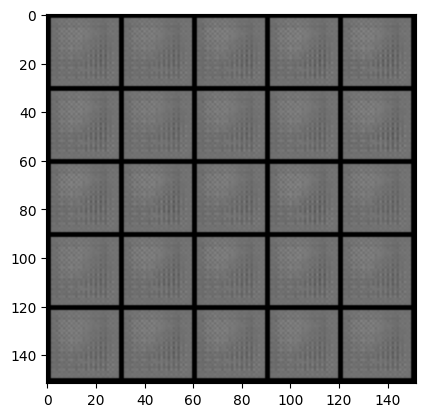

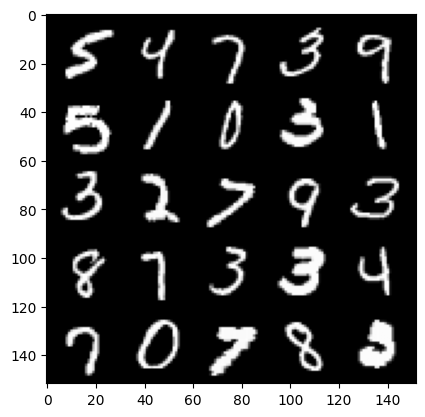

Epoch 0, step 400: Generator loss: 0.8415385314822198, discriminator loss: 0.5270618616044521


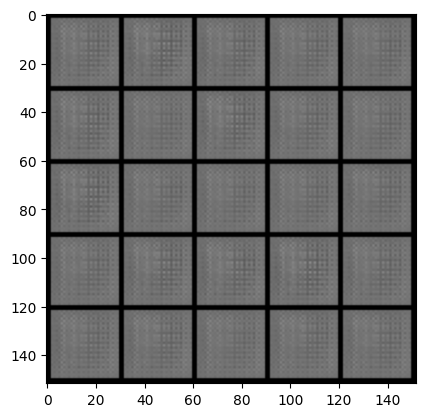

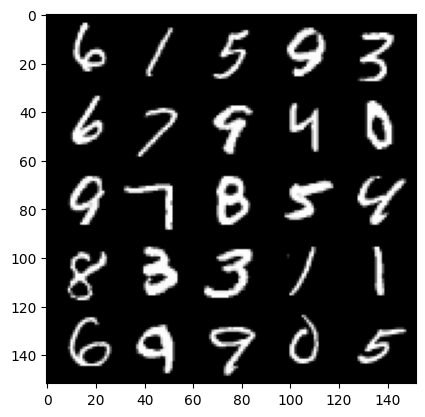

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 1, step 600: Generator loss: 1.1374136501550671, discriminator loss: 0.39855295687913894


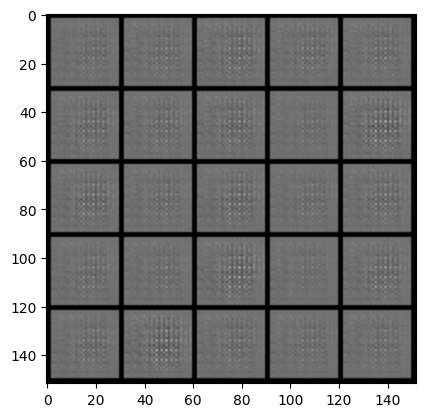

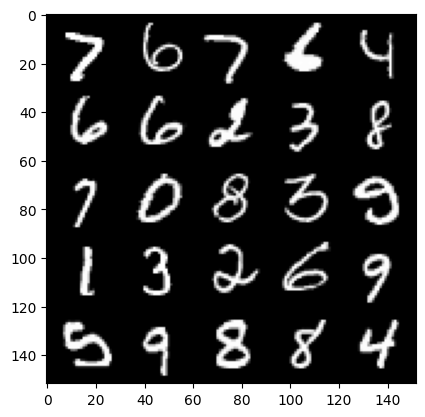

Epoch 1, step 800: Generator loss: 1.6770377212762844, discriminator loss: 0.23696805164217954


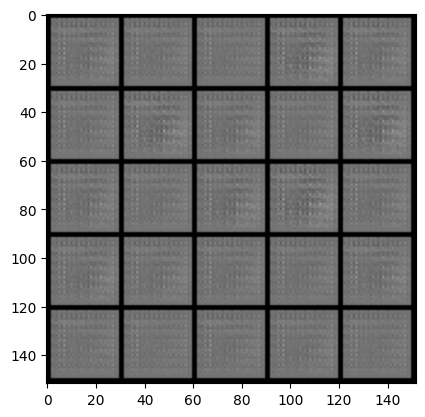

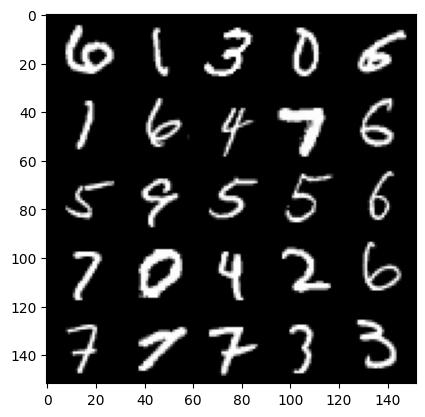

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 2, step 1000: Generator loss: 2.2565830254554746, discriminator loss: 0.1290467574447393


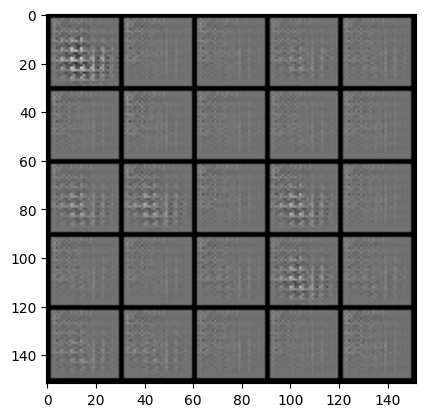

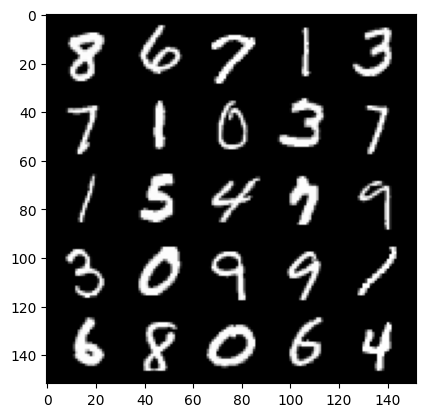

Epoch 2, step 1200: Generator loss: 2.7151468408107773, discriminator loss: 0.07973108045756822


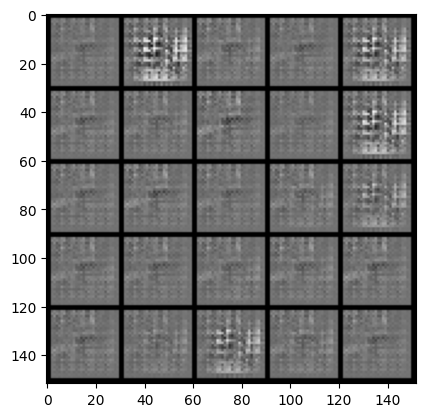

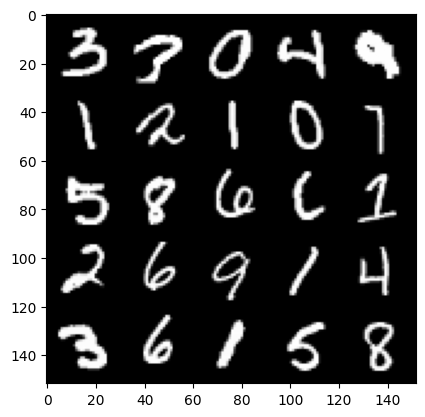

Epoch 2, step 1400: Generator loss: 3.171900378465654, discriminator loss: 0.057701350767165434


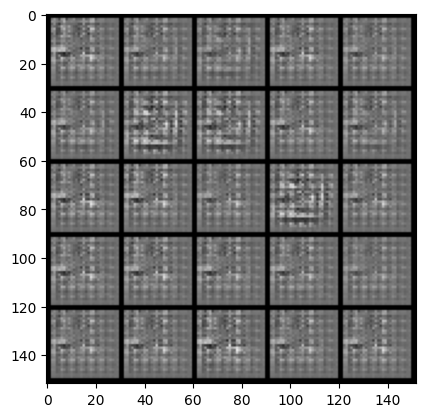

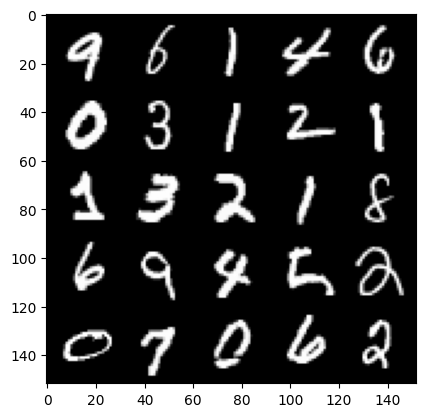

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 3, step 1600: Generator loss: 2.116761420816183, discriminator loss: 0.3715560064651072


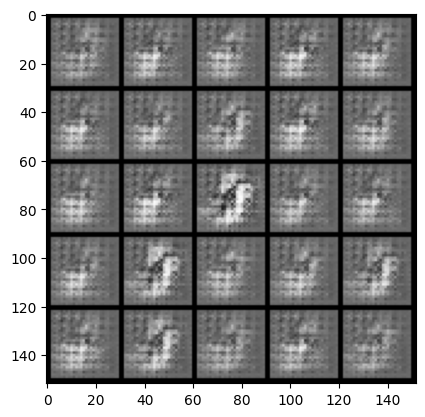

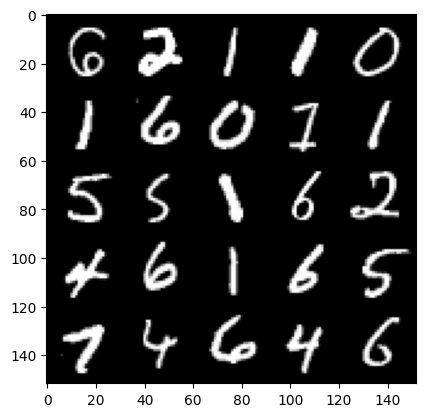

Epoch 3, step 1800: Generator loss: 1.3504916049540037, discriminator loss: 0.45612554967403407


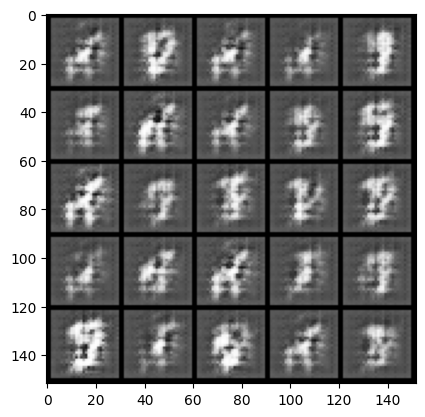

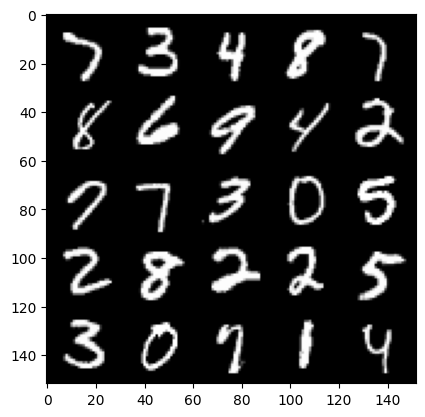

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 4, step 2000: Generator loss: 1.2480013597011568, discriminator loss: 0.49171785533428186


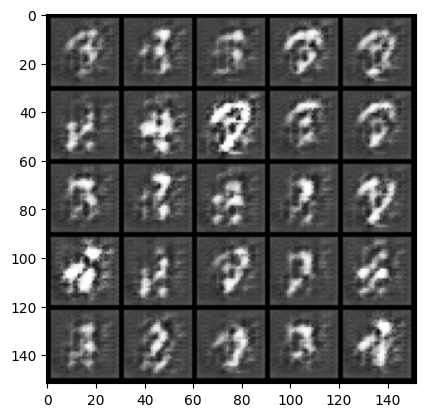

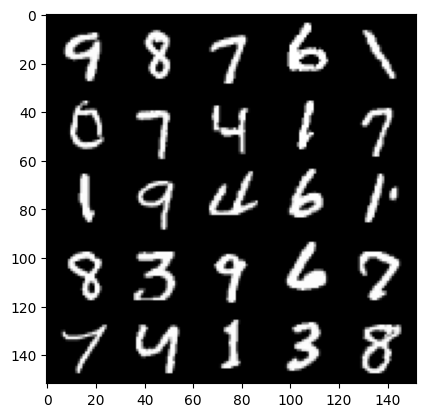

Epoch 4, step 2200: Generator loss: 1.1546441909670835, discriminator loss: 0.4963004359602929


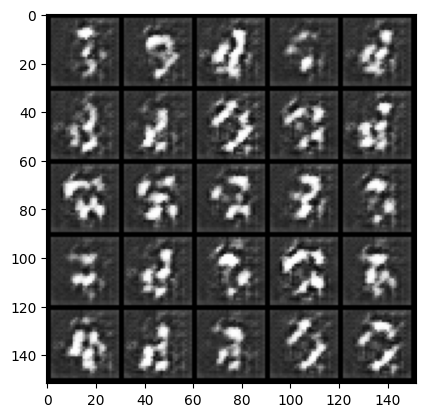

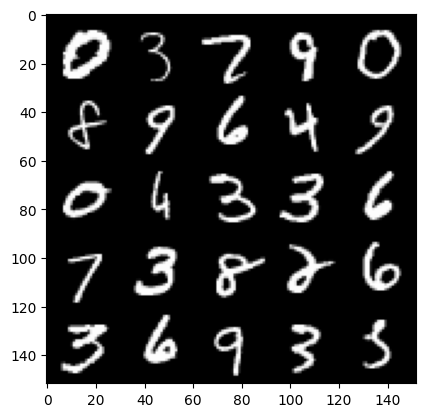

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 5, step 2400: Generator loss: 1.1642182805389176, discriminator loss: 0.4936221449077128


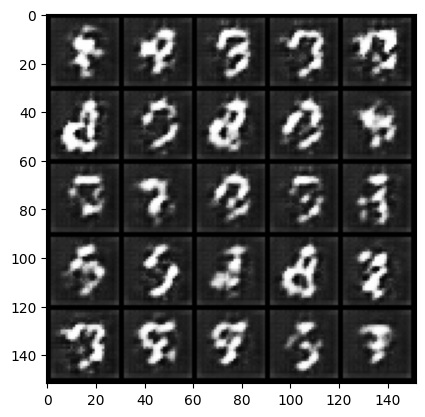

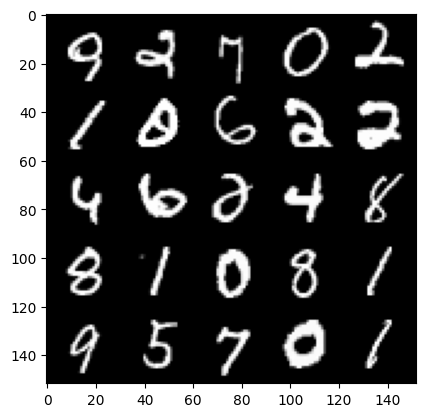

Epoch 5, step 2600: Generator loss: 1.1454182744026185, discriminator loss: 0.5059252315759659


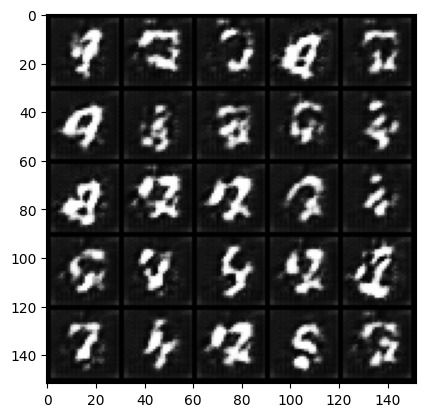

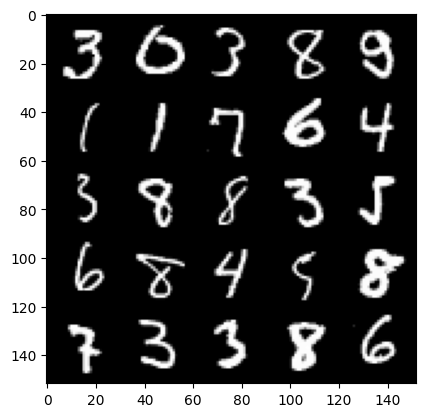

Epoch 5, step 2800: Generator loss: 1.0188653244823214, discriminator loss: 0.5464746636152267


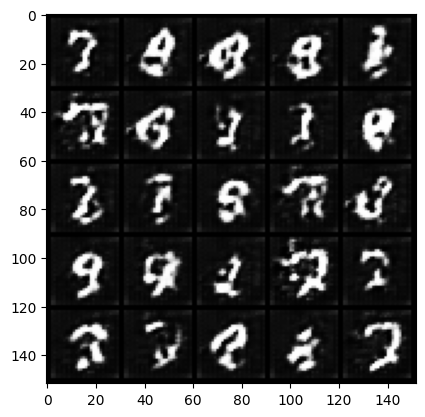

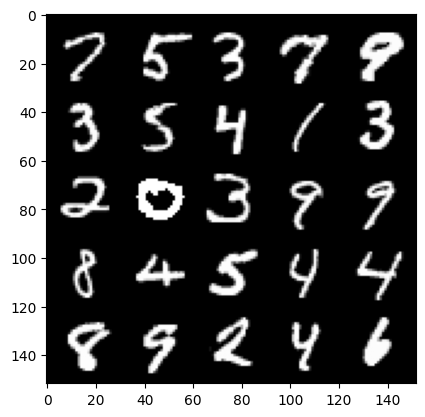

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 6, step 3000: Generator loss: 0.9767309109866623, discriminator loss: 0.5667845384776588


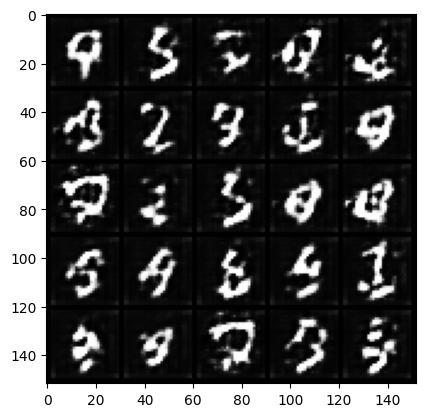

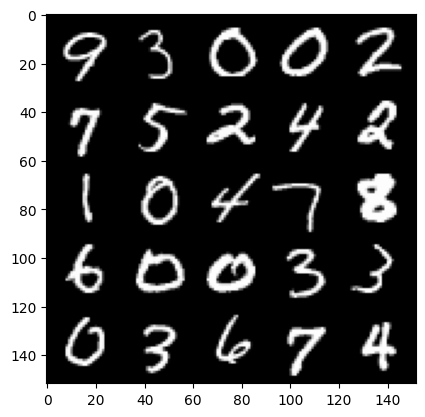

Epoch 6, step 3200: Generator loss: 0.9385416960716242, discriminator loss: 0.586573233306408


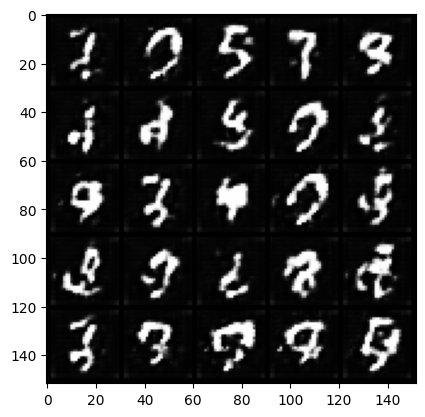

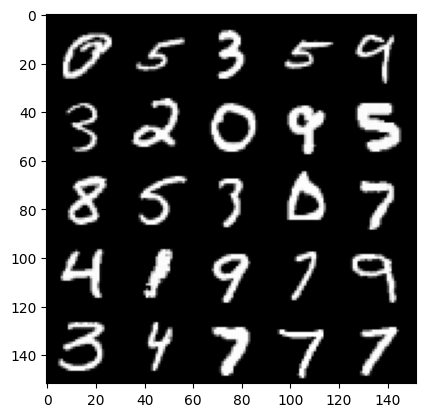

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 7, step 3400: Generator loss: 0.9111746519803995, discriminator loss: 0.5939985004067424


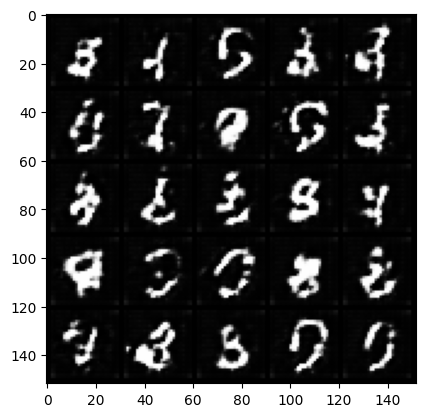

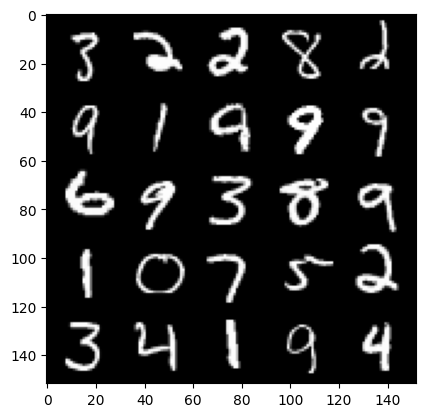

Epoch 7, step 3600: Generator loss: 0.9019165486097335, discriminator loss: 0.6030096390843387


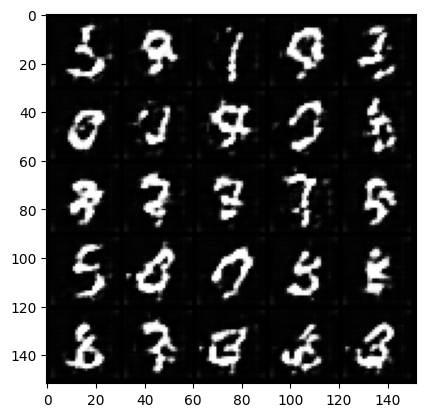

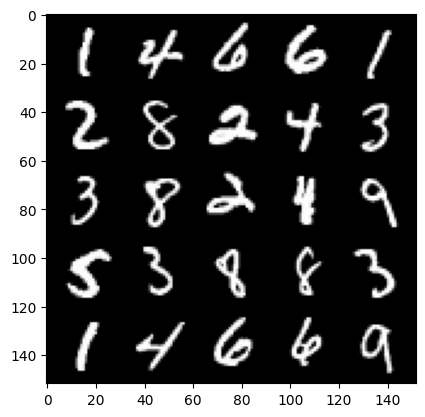

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 8, step 3800: Generator loss: 0.8867133012413977, discriminator loss: 0.6161438596248628


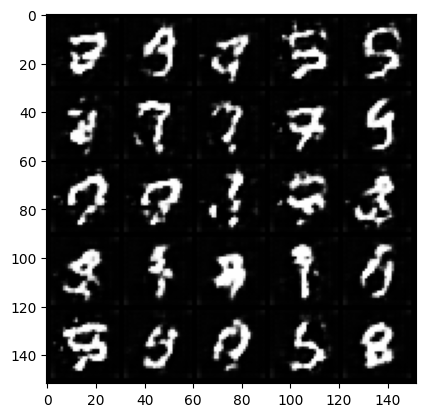

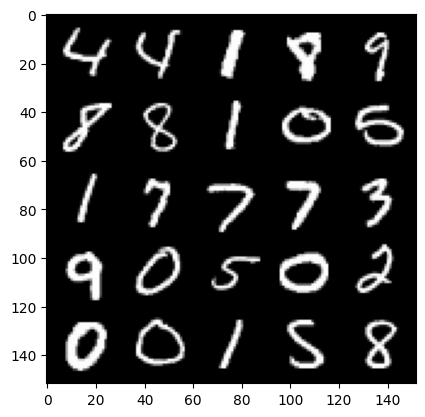

Epoch 8, step 4000: Generator loss: 0.849790862500668, discriminator loss: 0.6211088311672212


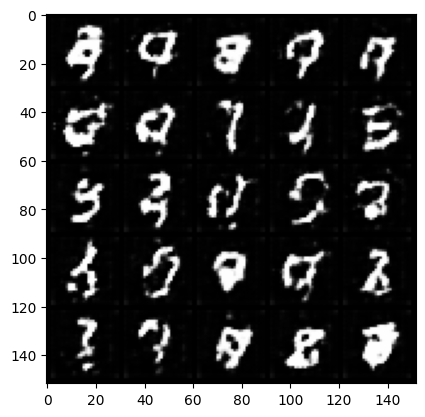

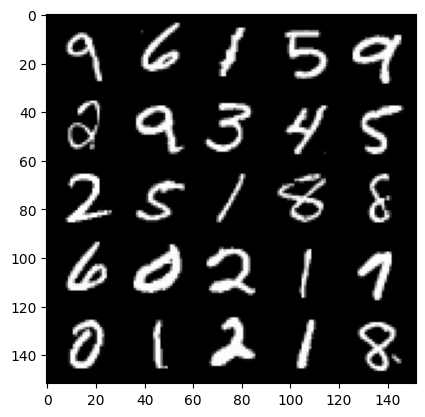

Epoch 8, step 4200: Generator loss: 0.8584142833948136, discriminator loss: 0.6177329596877098


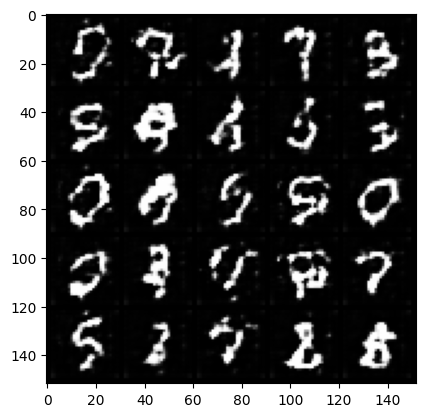

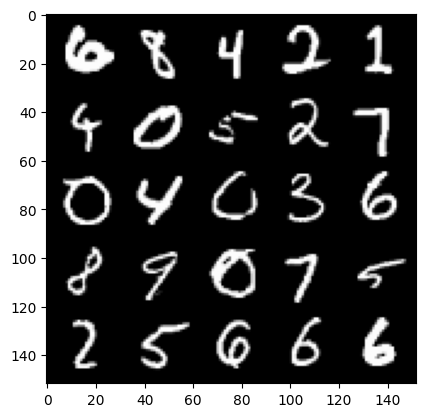

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 9, step 4400: Generator loss: 0.8618098214268682, discriminator loss: 0.625156635940075


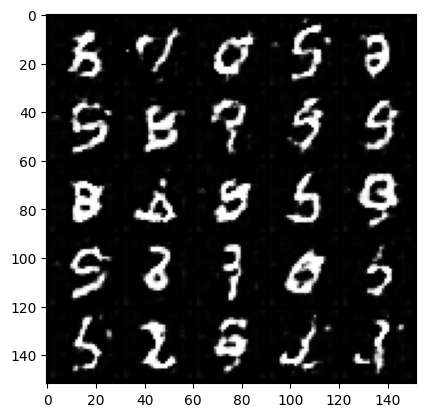

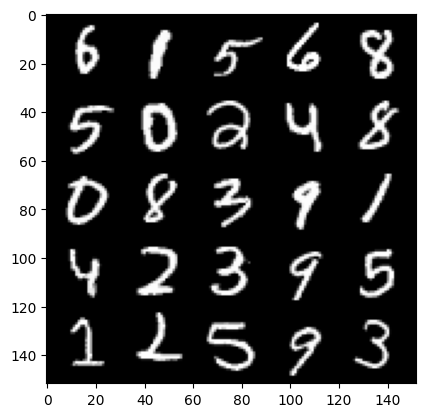

Epoch 9, step 4600: Generator loss: 0.8369992624223233, discriminator loss: 0.634228959977627


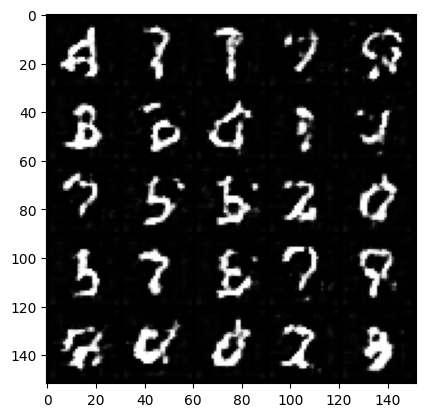

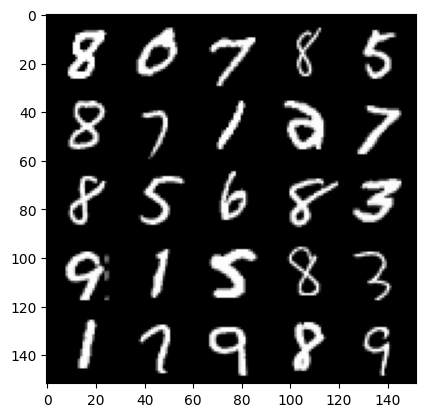

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 10, step 4800: Generator loss: 0.8401385131478306, discriminator loss: 0.6314715269207953


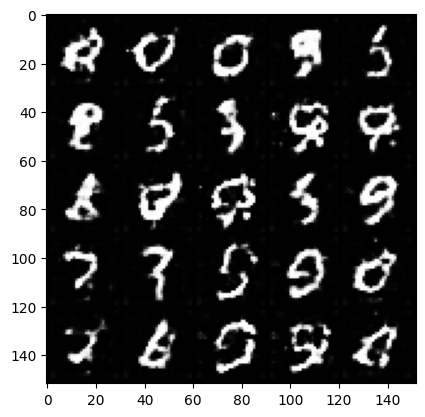

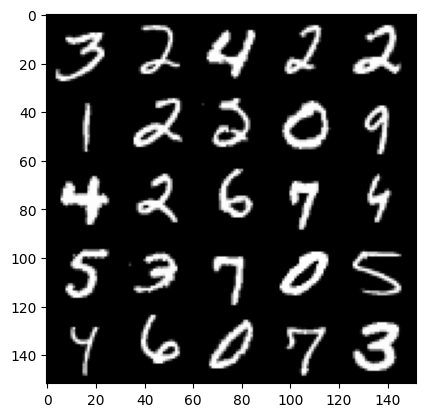

Epoch 10, step 5000: Generator loss: 0.8434317755699162, discriminator loss: 0.6391311806440348


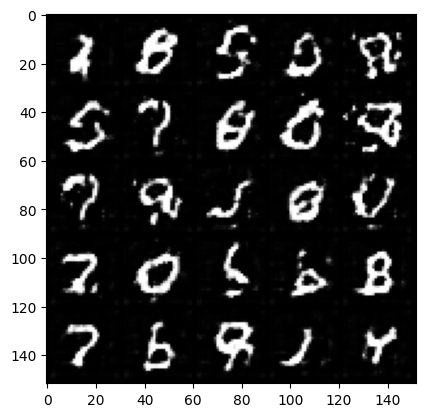

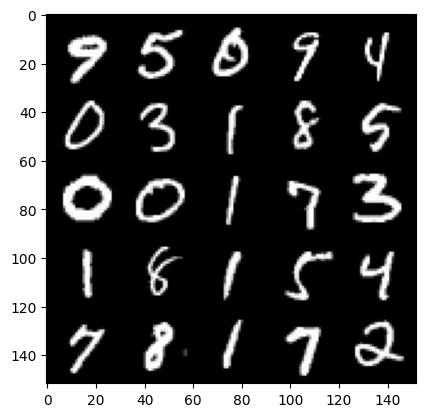

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 11, step 5200: Generator loss: 0.819275850057602, discriminator loss: 0.6408979958295824


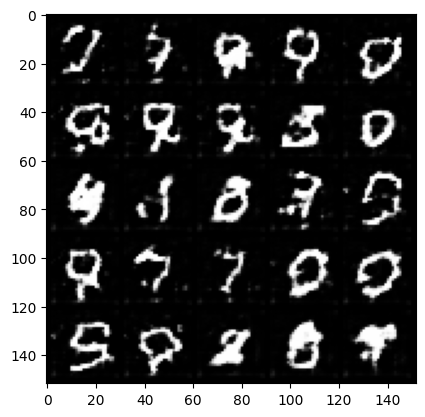

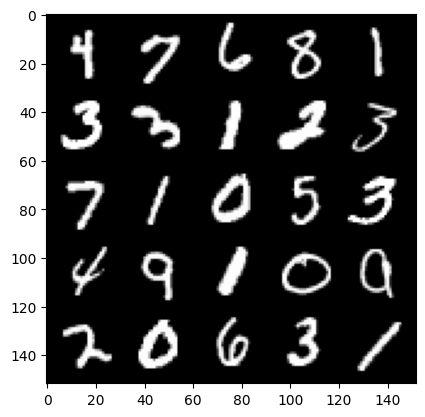

Epoch 11, step 5400: Generator loss: 0.8181010091304779, discriminator loss: 0.6488349339365961


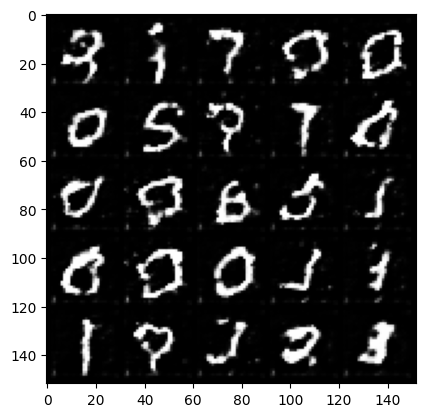

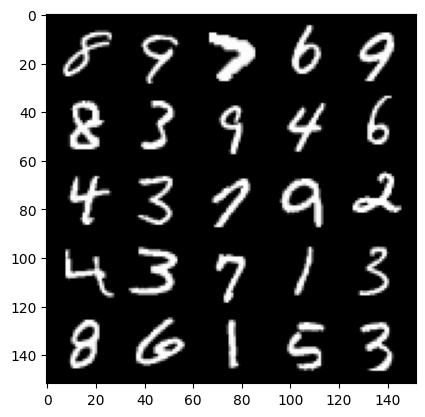

Epoch 11, step 5600: Generator loss: 0.7982218566536906, discriminator loss: 0.6528859919309618


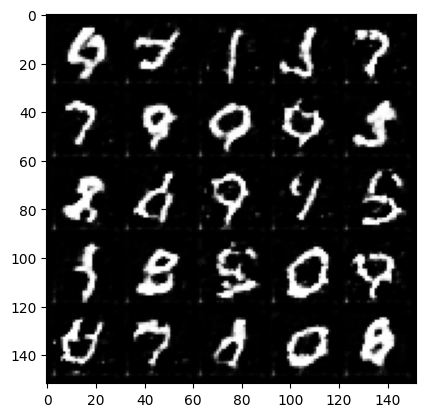

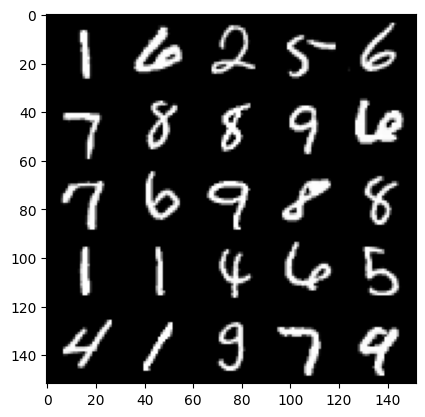

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 12, step 5800: Generator loss: 0.7985138480365279, discriminator loss: 0.6640464079380037


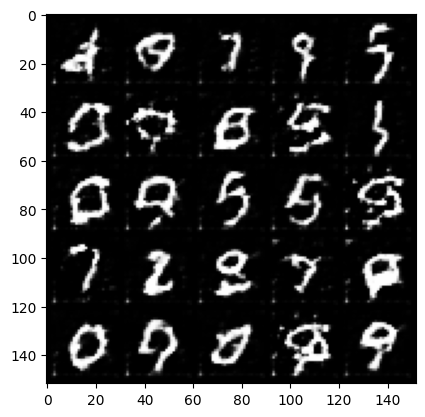

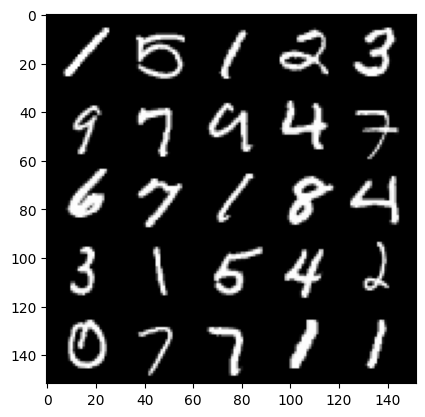

Epoch 12, step 6000: Generator loss: 0.7874968510866166, discriminator loss: 0.6632194080948826


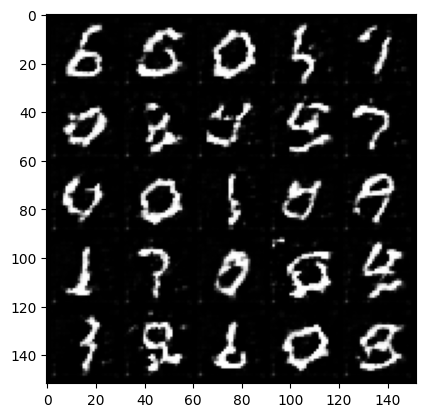

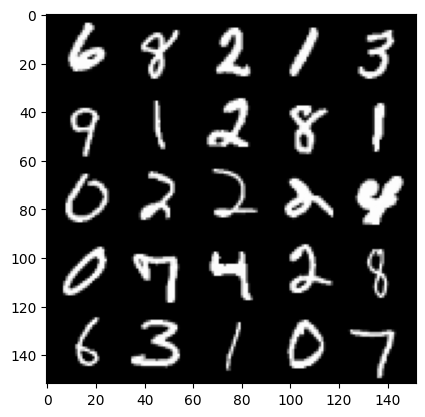

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 13, step 6200: Generator loss: 0.7840086606144905, discriminator loss: 0.6636131793260572


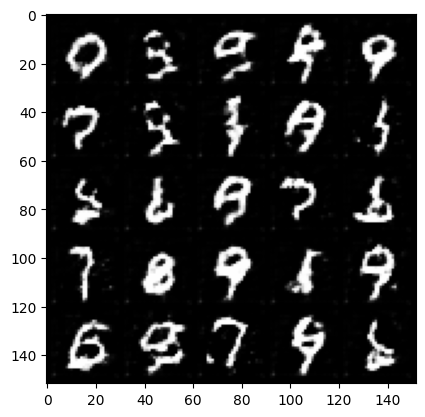

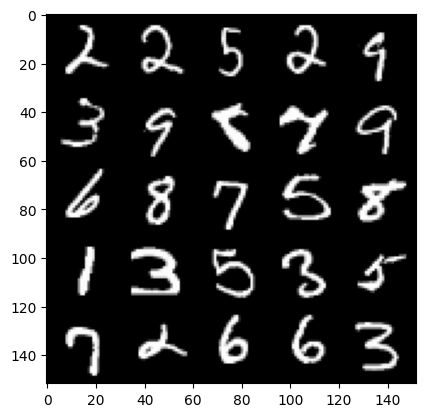

Epoch 13, step 6400: Generator loss: 0.78338594481349, discriminator loss: 0.664329912364483


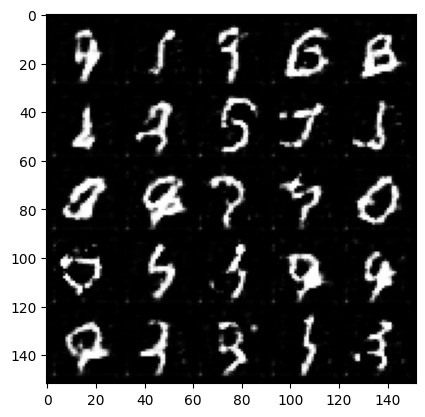

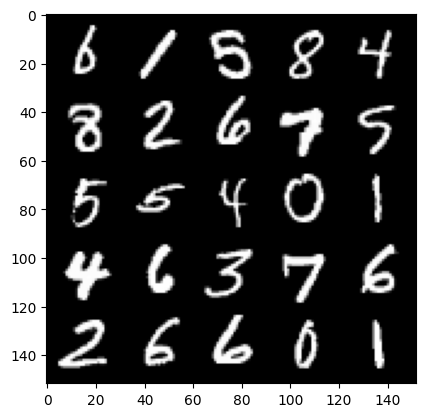

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 14, step 6600: Generator loss: 0.7838182346522803, discriminator loss: 0.670655745863914


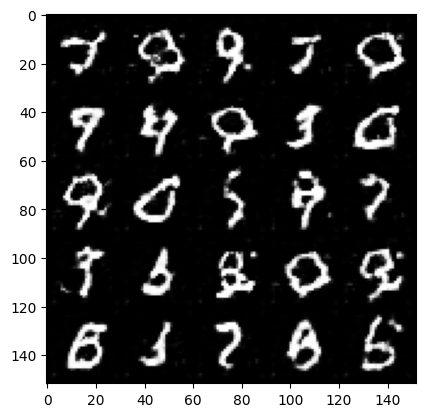

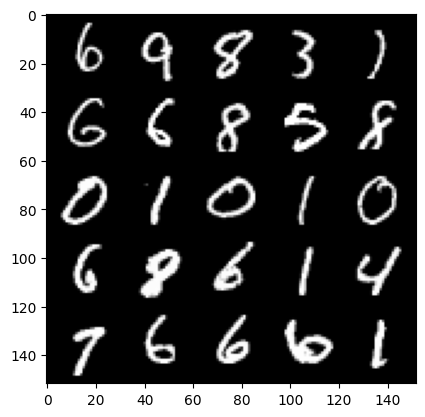

Epoch 14, step 6800: Generator loss: 0.7726839593052863, discriminator loss: 0.6693152931332589


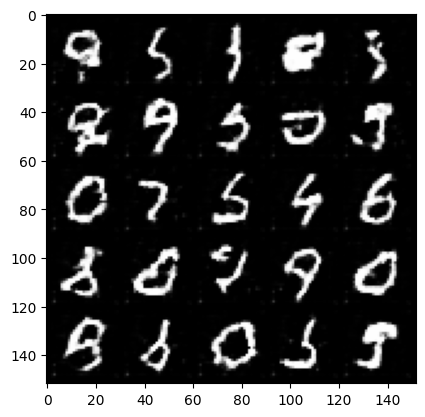

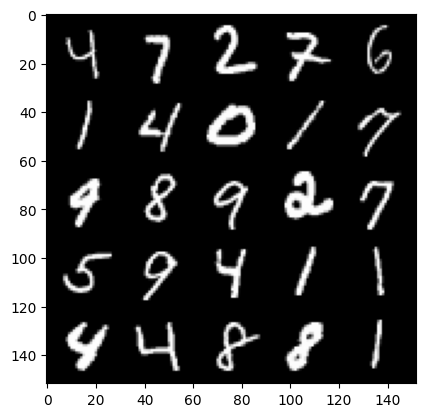

Epoch 14, step 7000: Generator loss: 0.7756970933079723, discriminator loss: 0.6726568928360942


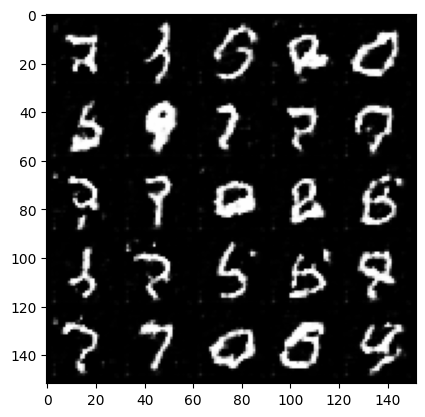

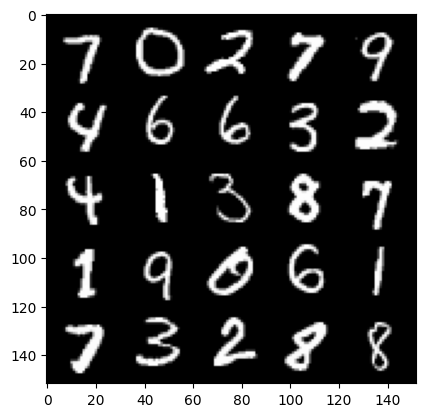

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 15, step 7200: Generator loss: 0.7692038610577581, discriminator loss: 0.6736171552538868


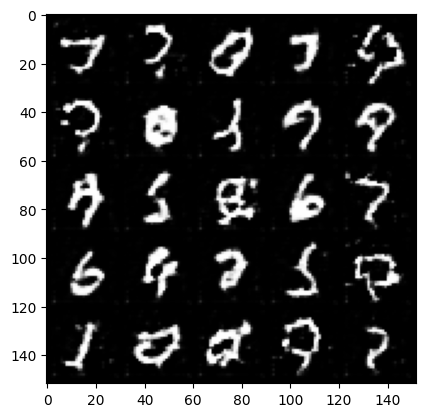

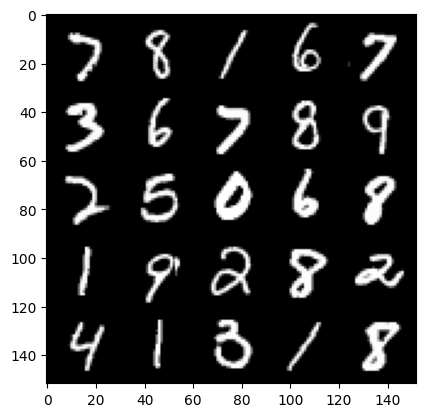

Epoch 15, step 7400: Generator loss: 0.7731238201260565, discriminator loss: 0.6767430958151817


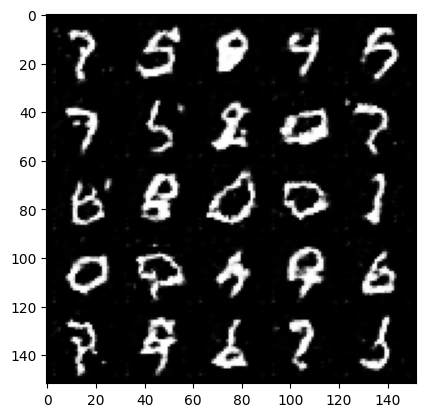

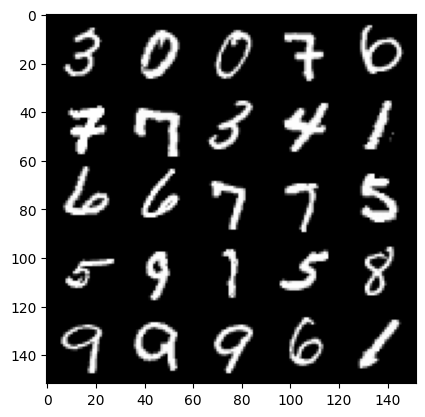

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 16, step 7600: Generator loss: 0.7618342447280884, discriminator loss: 0.6760071066021923


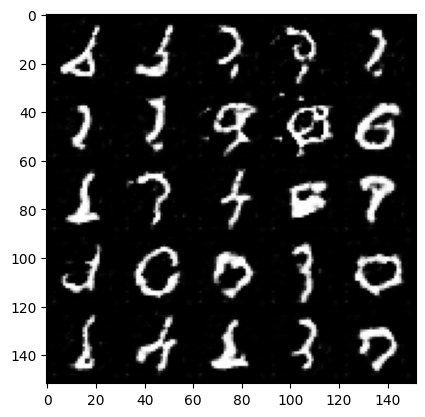

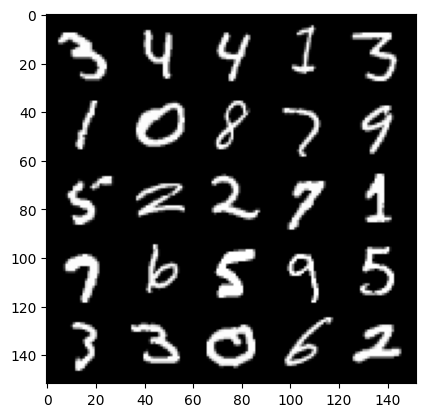

Epoch 16, step 7800: Generator loss: 0.7676543292403218, discriminator loss: 0.6770962750911717


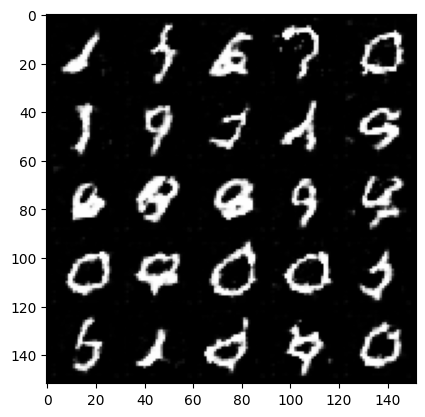

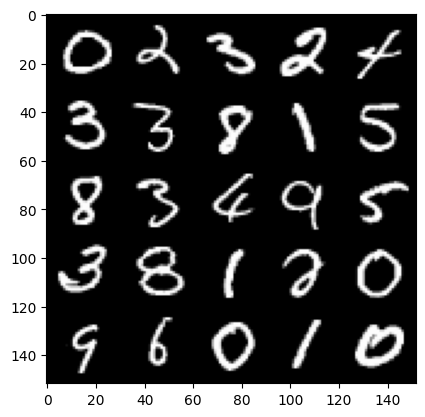

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 17, step 8000: Generator loss: 0.7646272993087768, discriminator loss: 0.6766157135367389


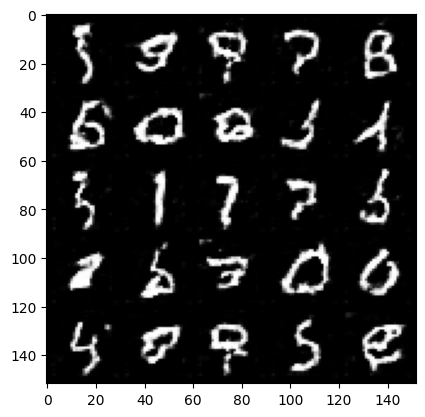

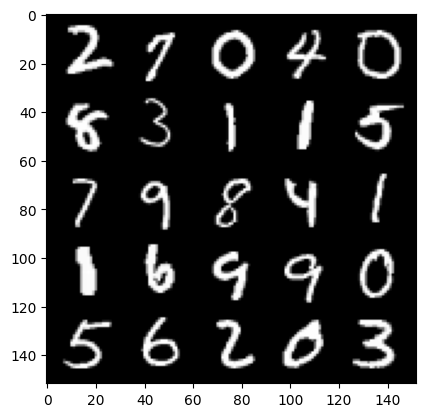

Epoch 17, step 8200: Generator loss: 0.756401570141316, discriminator loss: 0.6788645842671395


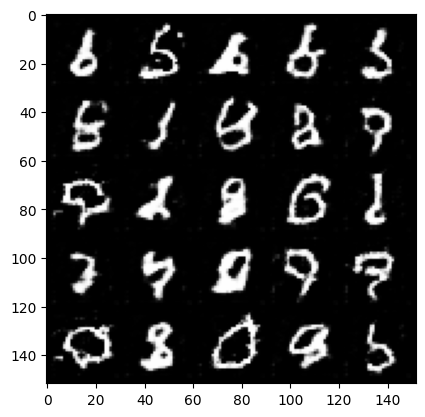

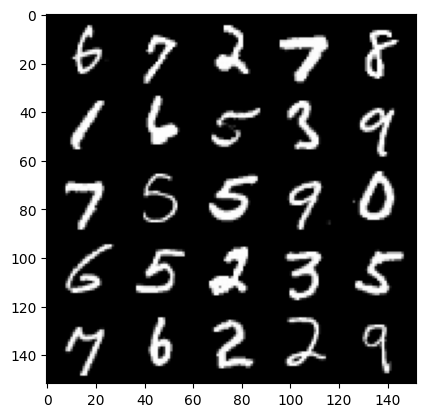

Epoch 17, step 8400: Generator loss: 0.7579318809509276, discriminator loss: 0.6796265193819997


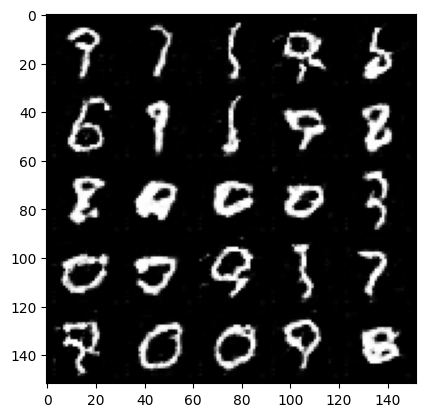

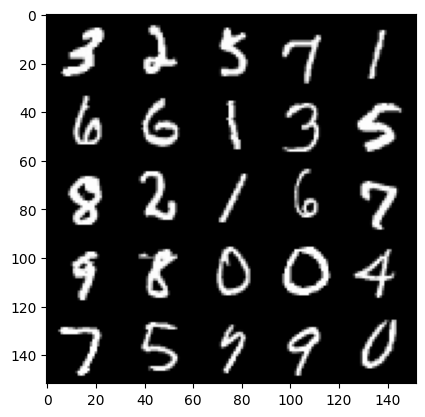

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 18, step 8600: Generator loss: 0.7520383065938945, discriminator loss: 0.6803062146902085


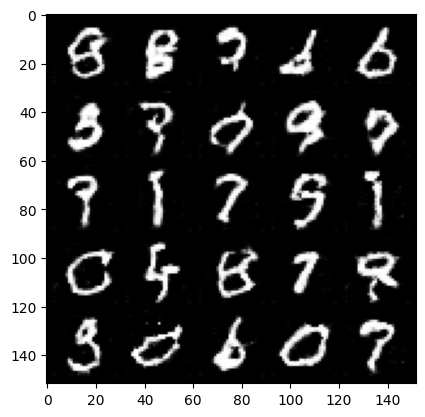

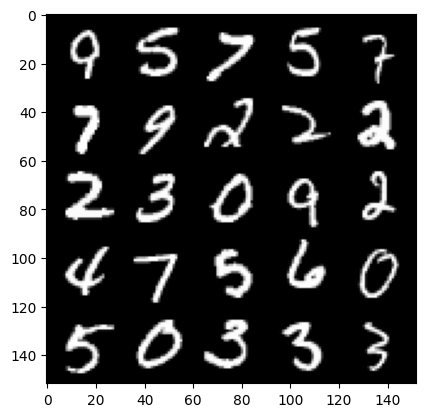

Epoch 18, step 8800: Generator loss: 0.749464037120342, discriminator loss: 0.6841639983654018


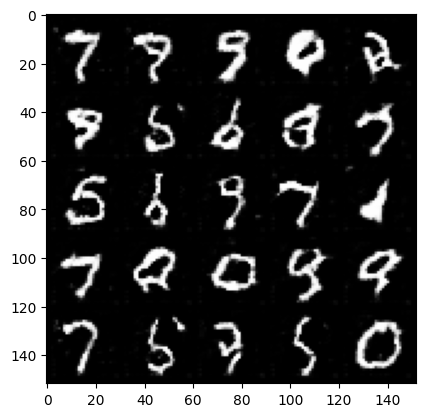

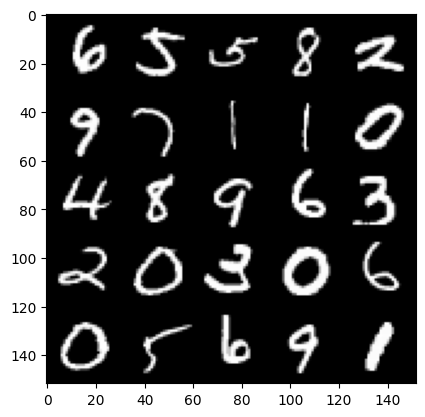

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 19, step 9000: Generator loss: 0.7520326009392742, discriminator loss: 0.6844278016686439


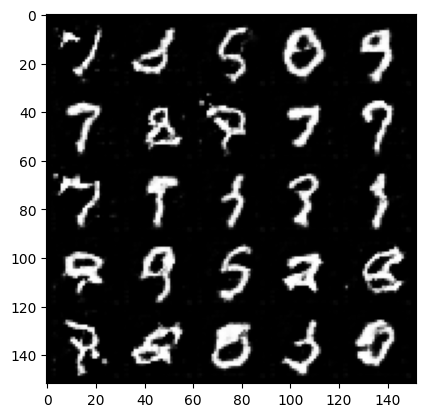

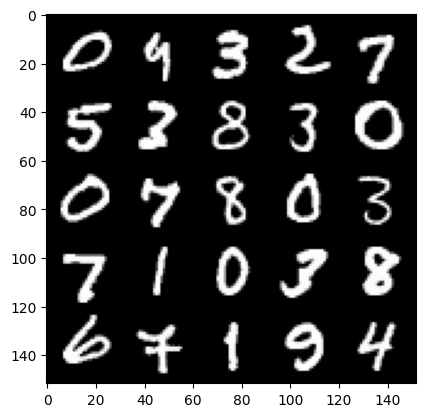

Epoch 19, step 9200: Generator loss: 0.7454759049415586, discriminator loss: 0.6857331097126007


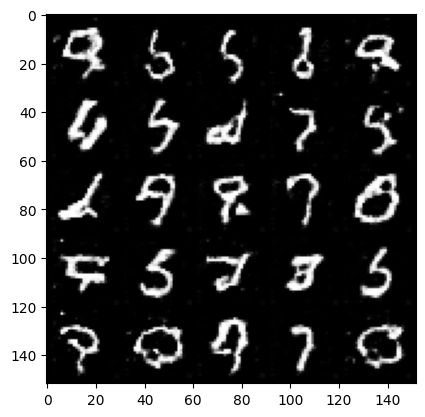

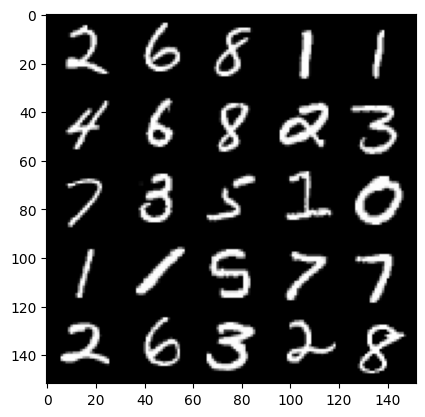

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 20, step 9400: Generator loss: 0.7487271106243132, discriminator loss: 0.682972608804703


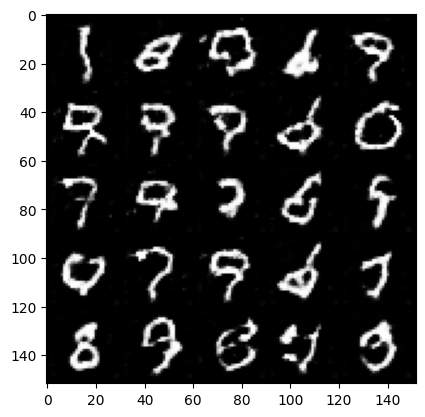

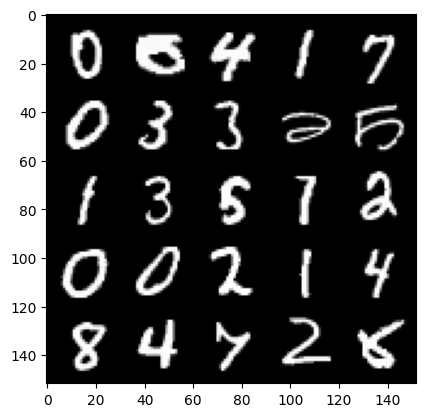

Epoch 20, step 9600: Generator loss: 0.7493757808208463, discriminator loss: 0.6856390577554702


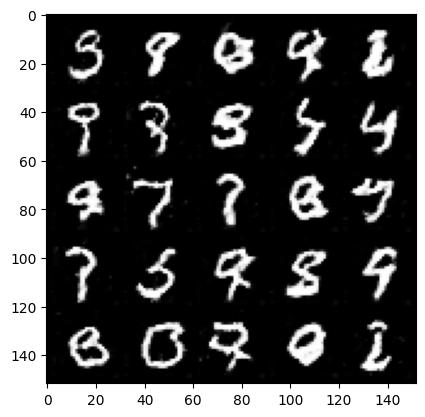

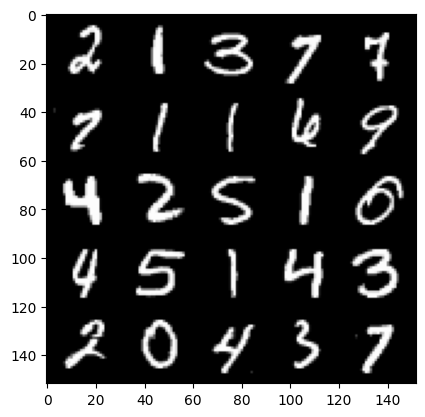

Epoch 20, step 9800: Generator loss: 0.7414114463329311, discriminator loss: 0.6856833124160764


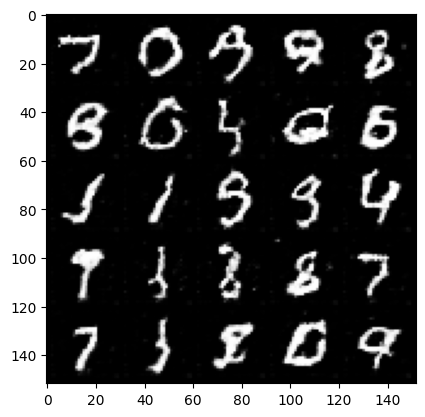

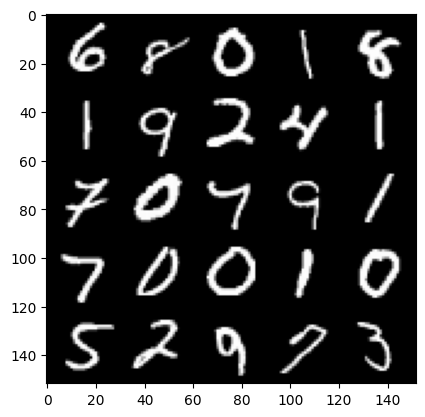

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 21, step 10000: Generator loss: 0.7416596853733061, discriminator loss: 0.687321991920471


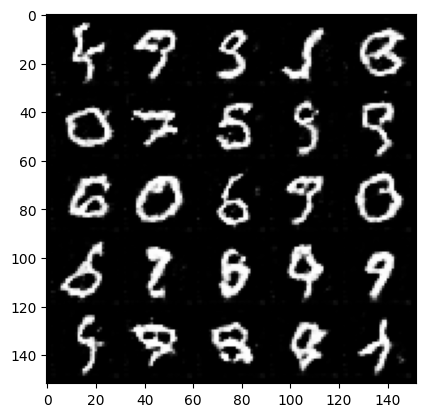

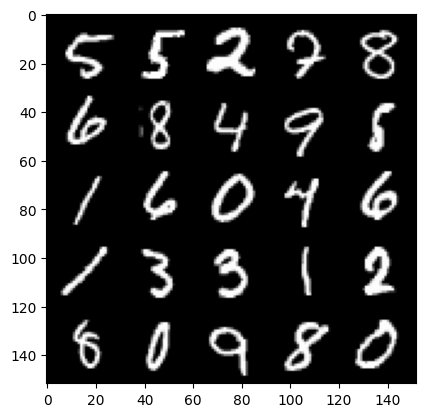

Epoch 21, step 10200: Generator loss: 0.7414931675791742, discriminator loss: 0.6905714985728268


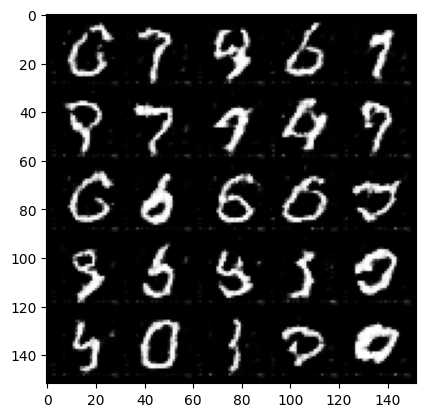

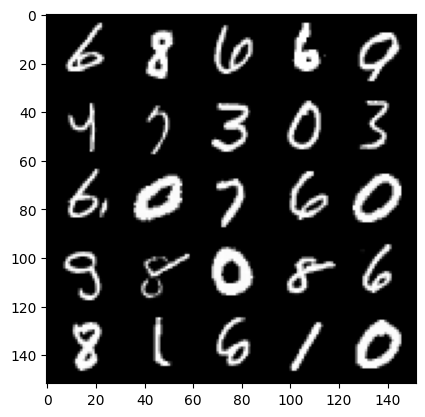

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 22, step 10400: Generator loss: 0.7367552730441093, discriminator loss: 0.6895171275734898


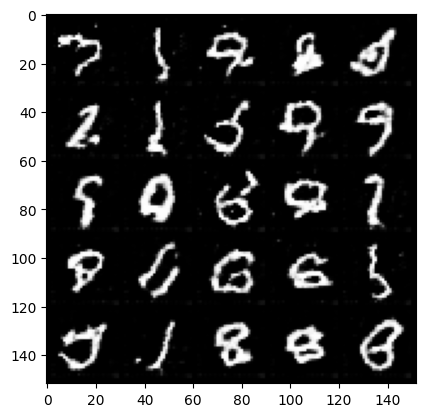

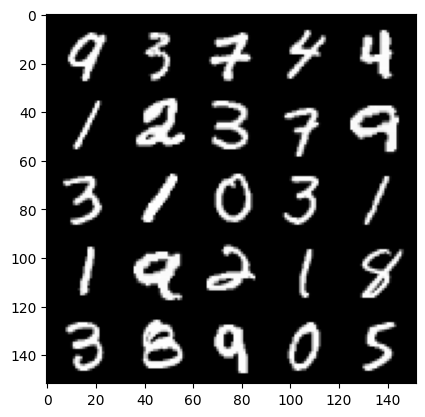

Epoch 22, step 10600: Generator loss: 0.74060095757246, discriminator loss: 0.689603191614151


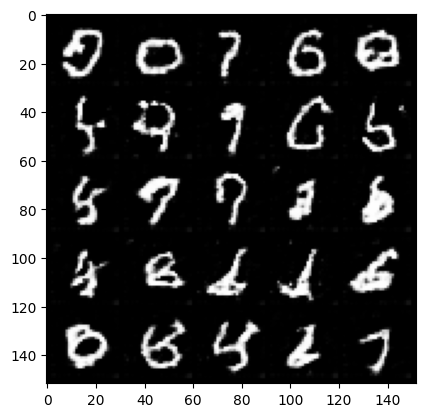

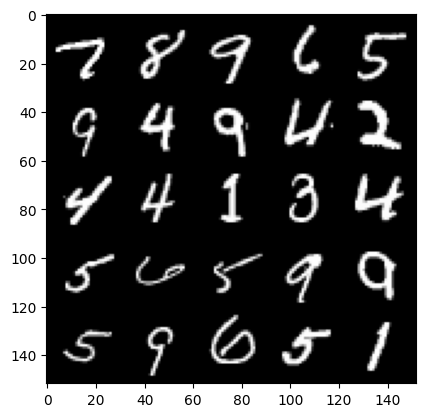

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 23, step 10800: Generator loss: 0.7352340069413181, discriminator loss: 0.689766040444374


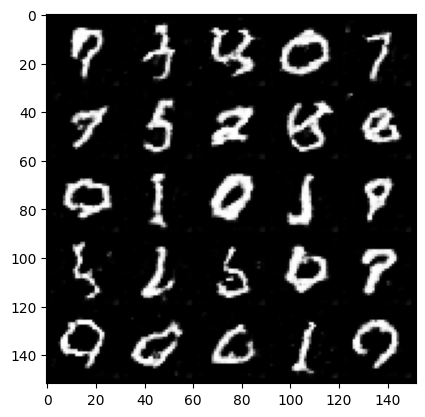

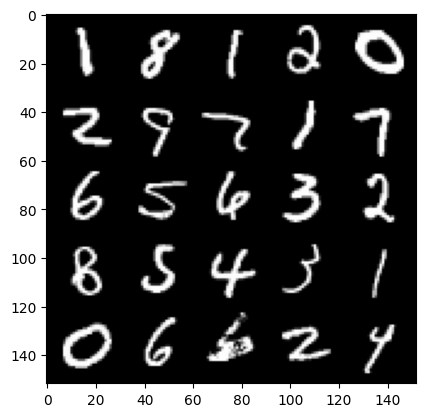

Epoch 23, step 11000: Generator loss: 0.729534292221069, discriminator loss: 0.6907615080475807


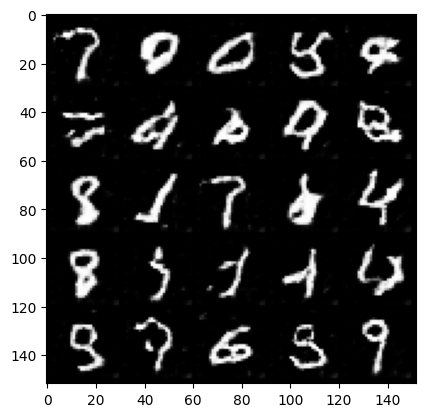

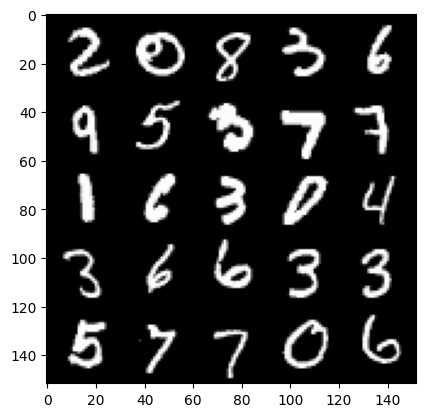

Epoch 23, step 11200: Generator loss: 0.7246917271614078, discriminator loss: 0.6915890875458721


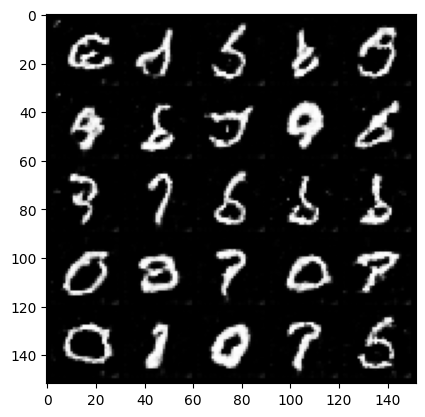

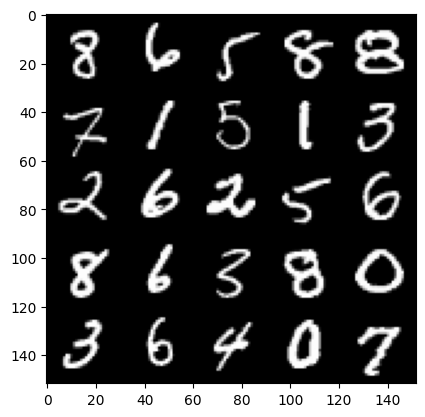

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 24, step 11400: Generator loss: 0.7326230752468114, discriminator loss: 0.6919277143478392


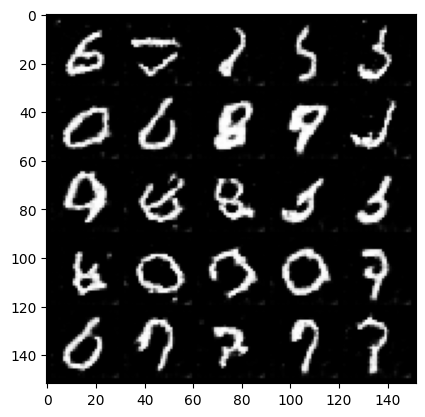

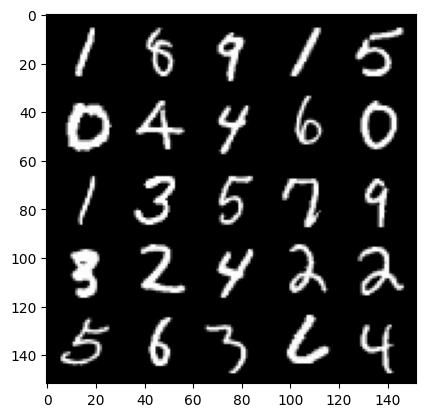

Epoch 24, step 11600: Generator loss: 0.7247339922189711, discriminator loss: 0.6943189111351967


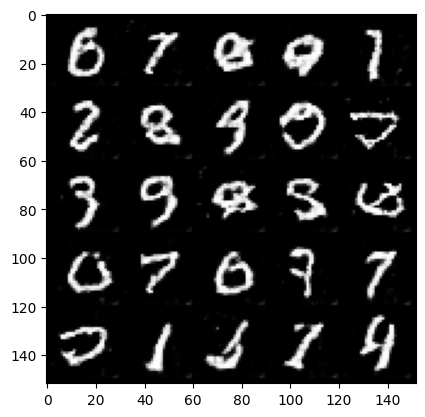

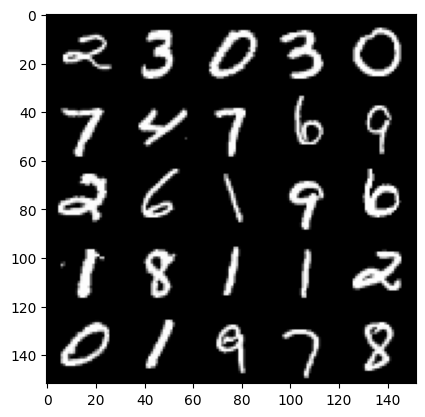

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 25, step 11800: Generator loss: 0.7187352469563485, discriminator loss: 0.6946365332603459


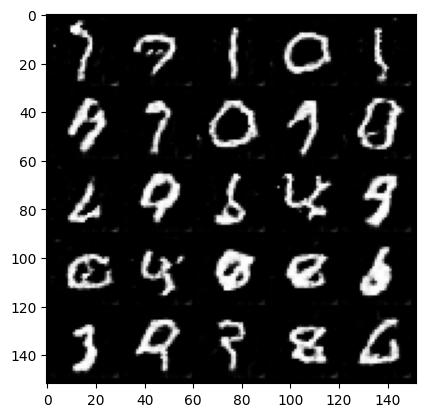

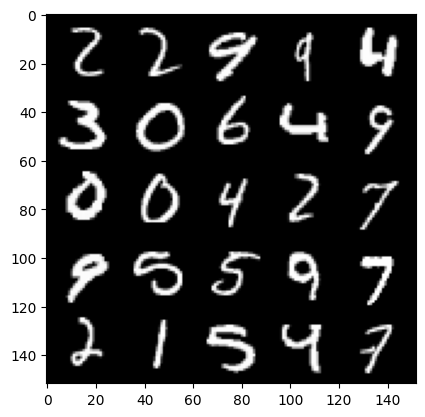

Epoch 25, step 12000: Generator loss: 0.7213530910015107, discriminator loss: 0.6946804267168046


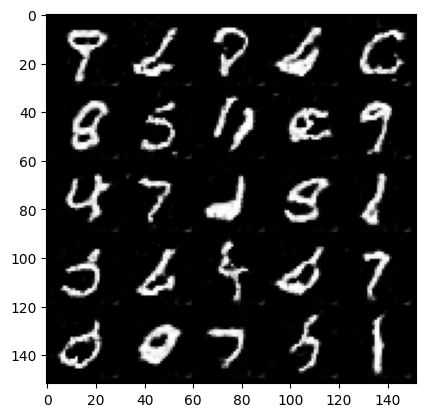

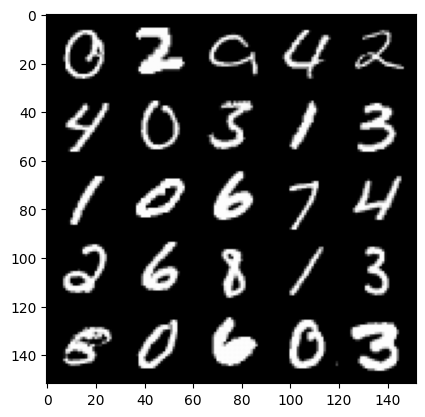

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 26, step 12200: Generator loss: 0.7169973894953727, discriminator loss: 0.6955180057883262


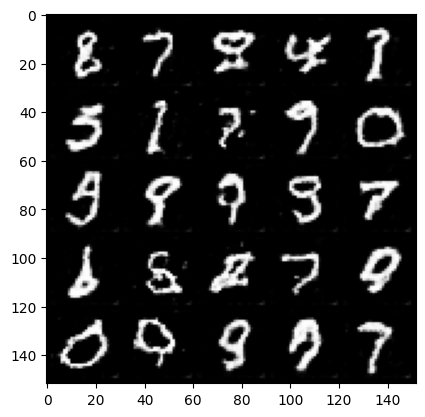

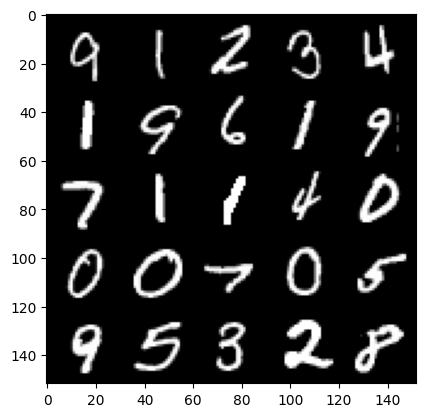

Epoch 26, step 12400: Generator loss: 0.7172538760304451, discriminator loss: 0.6968533879518506


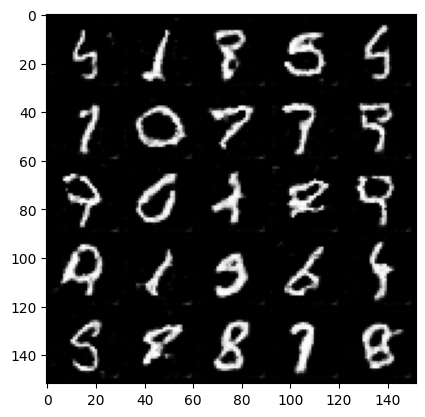

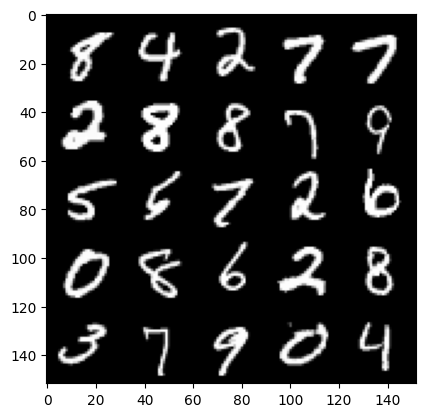

Epoch 26, step 12600: Generator loss: 0.7155695711076258, discriminator loss: 0.6976591247320171


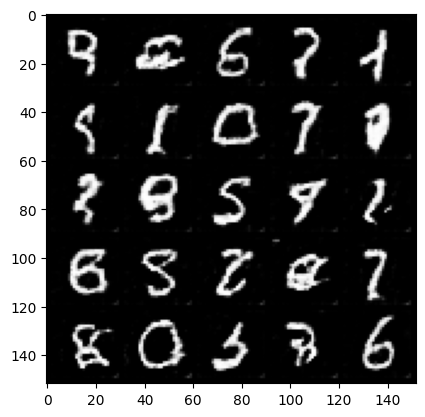

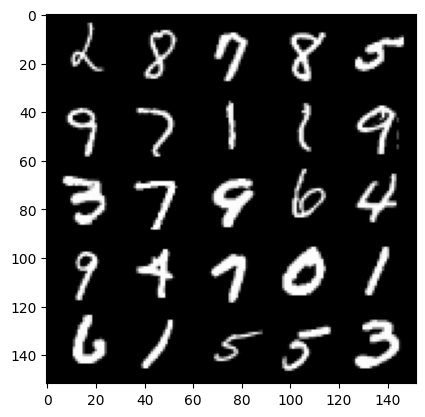

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 27, step 12800: Generator loss: 0.7120125079154965, discriminator loss: 0.6979798740148537


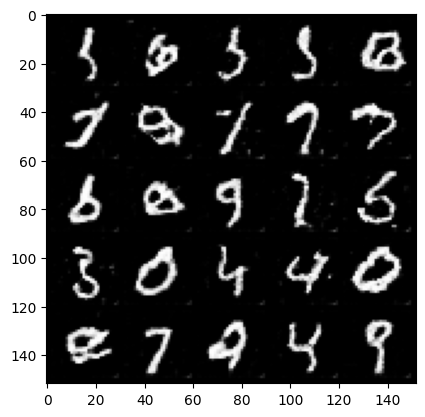

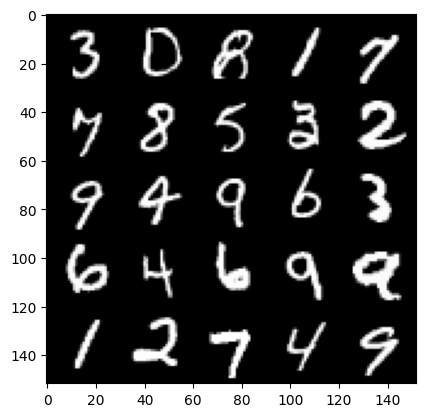

Epoch 27, step 13000: Generator loss: 0.7129415866732598, discriminator loss: 0.700655722618103


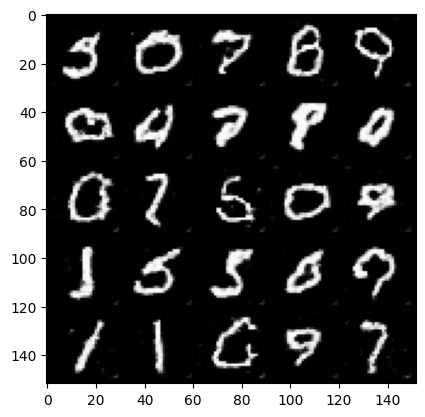

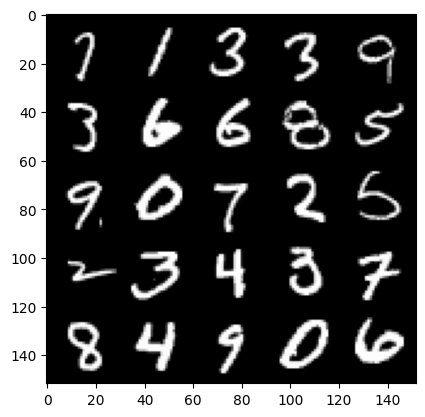

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 28, step 13200: Generator loss: 0.711452219486237, discriminator loss: 0.7001160433888434


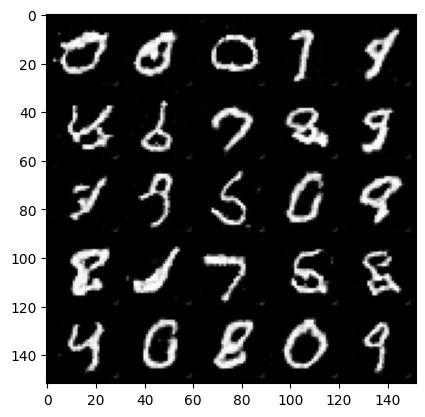

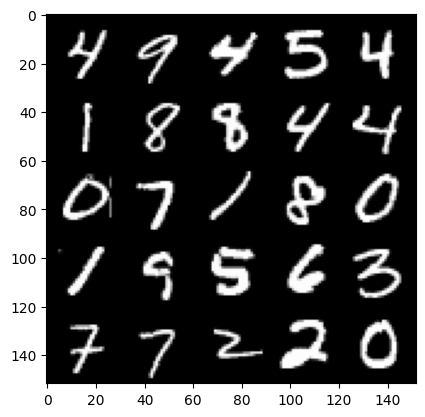

Epoch 28, step 13400: Generator loss: 0.7073921468853952, discriminator loss: 0.7002077013254173


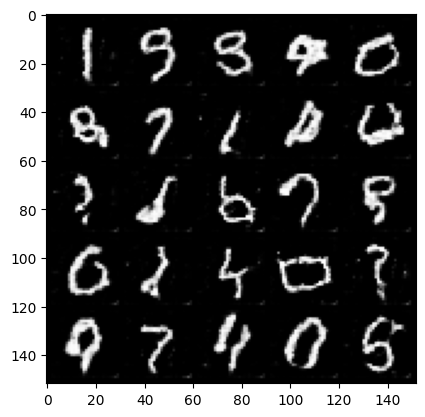

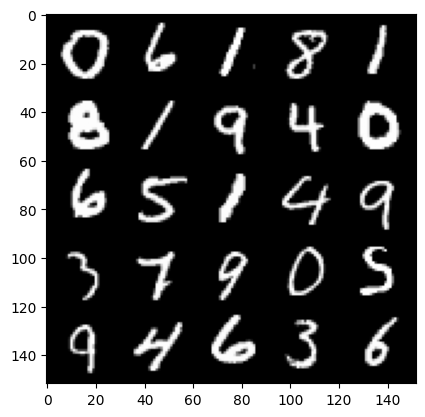

Epoch 28, step 13600: Generator loss: 0.7073691013455391, discriminator loss: 0.7002176290750498


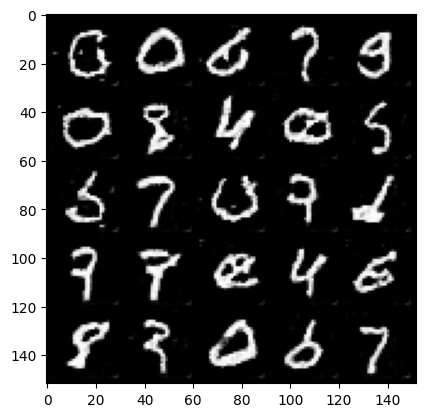

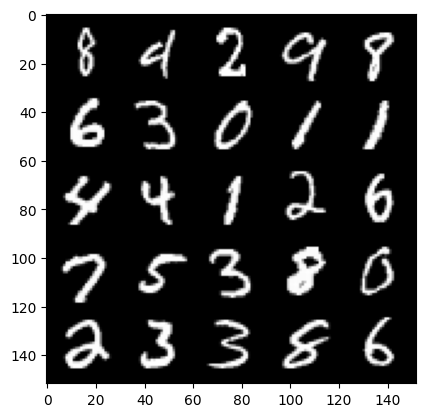

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 29, step 13800: Generator loss: 0.7054379332065586, discriminator loss: 0.6992865046858785


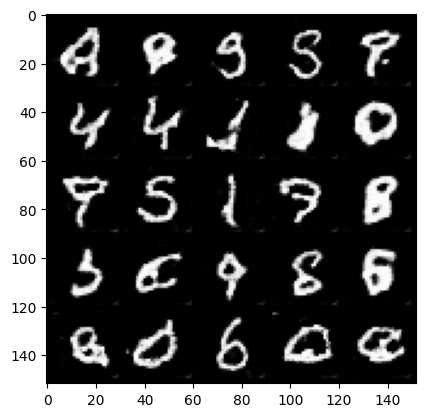

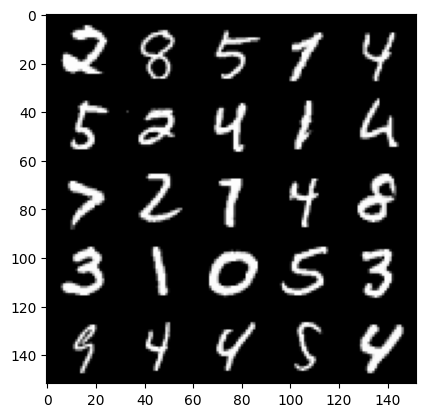

Epoch 29, step 14000: Generator loss: 0.7028052085638052, discriminator loss: 0.7005054149031641


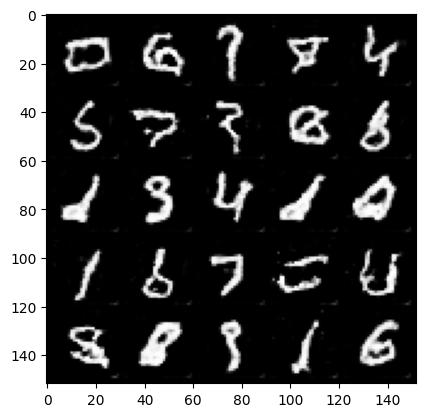

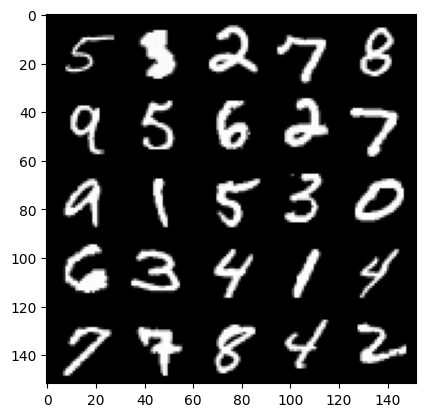

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 30, step 14200: Generator loss: 0.7070264285802843, discriminator loss: 0.7018933659791937


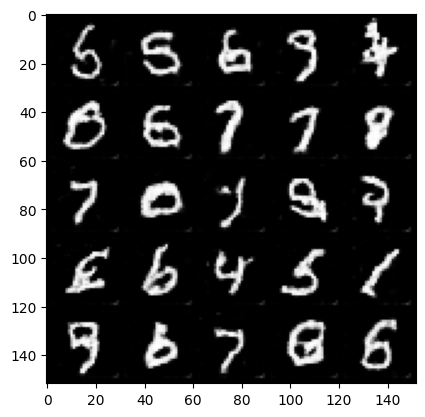

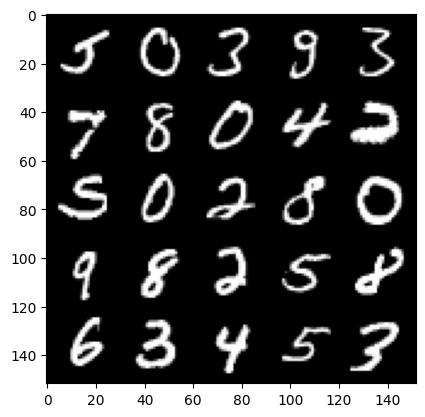

Epoch 30, step 14400: Generator loss: 0.7043073290586472, discriminator loss: 0.700368511080742


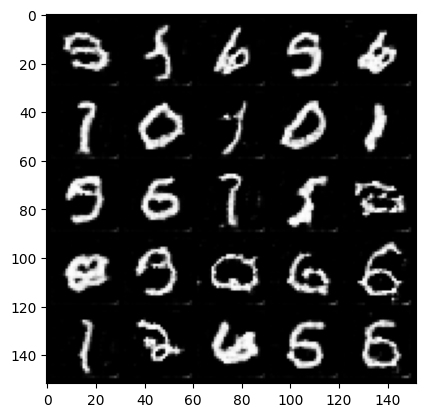

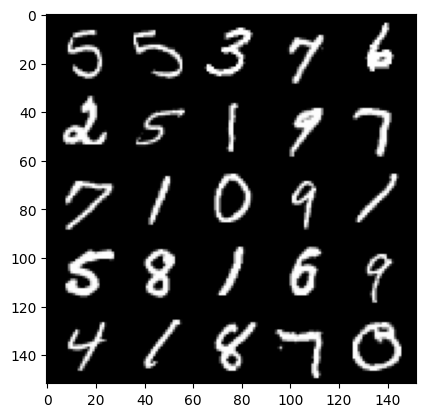

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 31, step 14600: Generator loss: 0.703637165725231, discriminator loss: 0.700316389501095


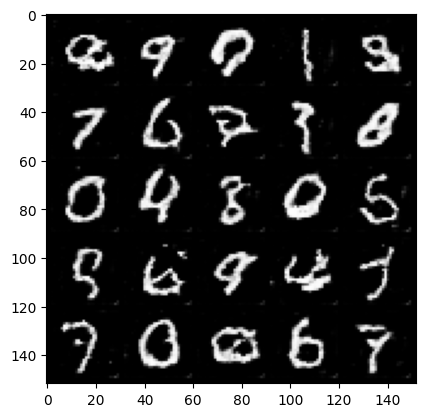

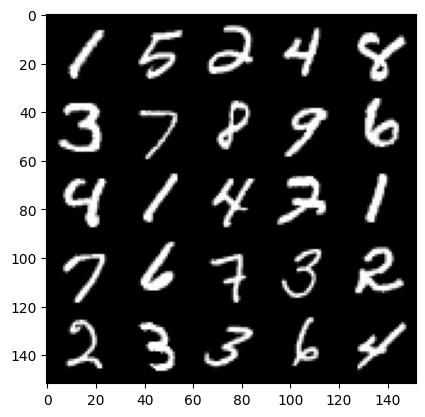

Epoch 31, step 14800: Generator loss: 0.701476406753063, discriminator loss: 0.7007082152366637


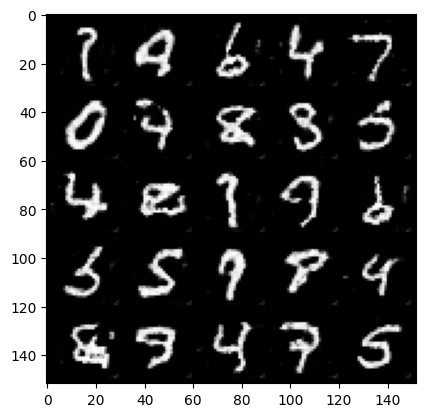

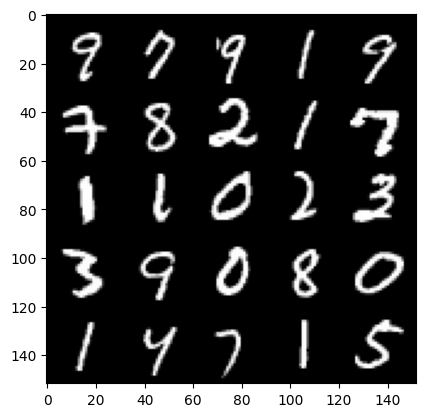

Epoch 31, step 15000: Generator loss: 0.7053724557161332, discriminator loss: 0.7005835944414138


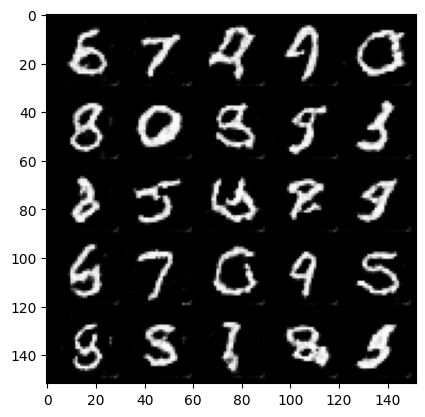

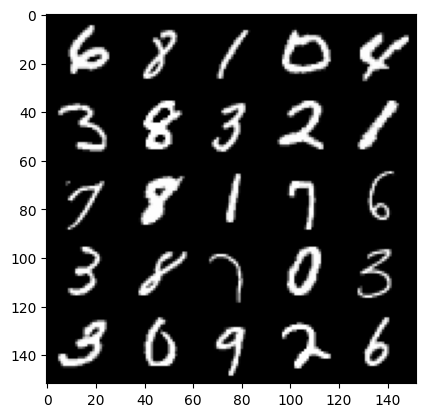

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 32, step 15200: Generator loss: 0.7022141087055207, discriminator loss: 0.7005141270160684


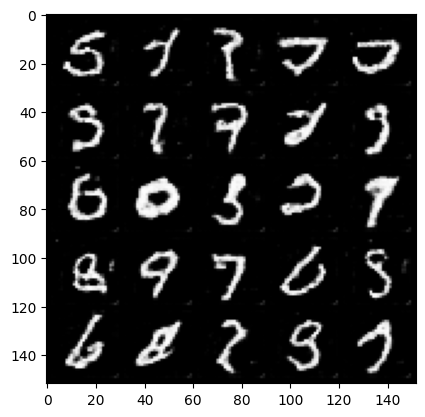

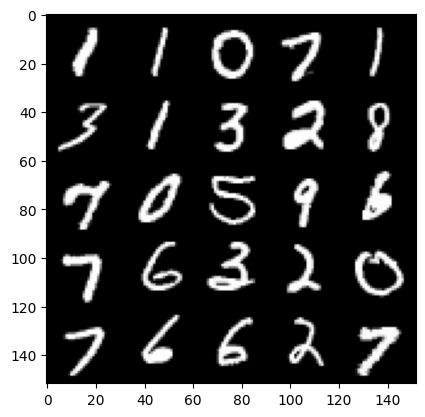

Epoch 32, step 15400: Generator loss: 0.7032030880451198, discriminator loss: 0.7000388702750208


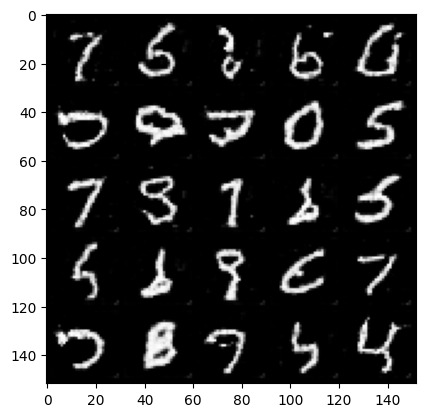

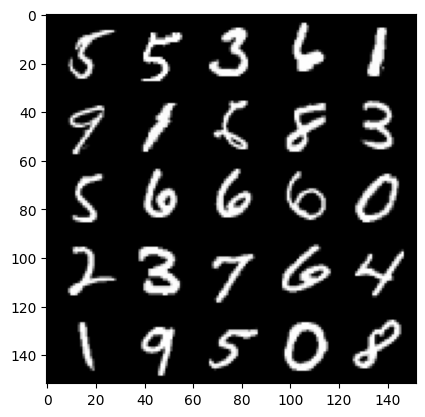

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 33, step 15600: Generator loss: 0.7003314623236657, discriminator loss: 0.6993548038601878


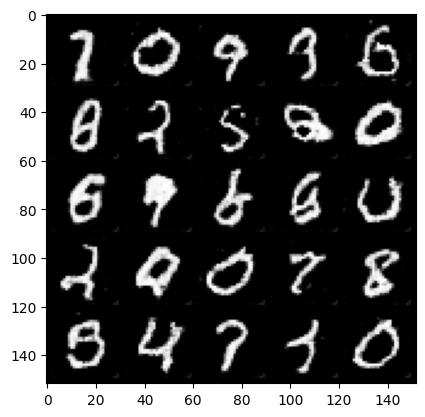

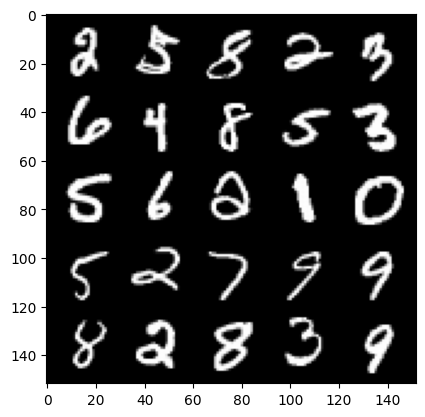

Epoch 33, step 15800: Generator loss: 0.7037120795249939, discriminator loss: 0.6999582988023759


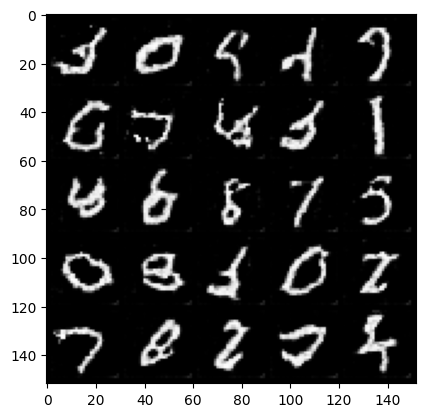

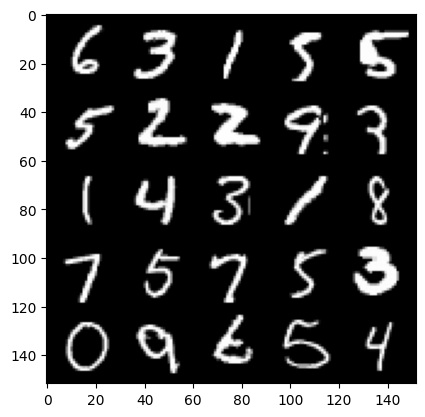

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 34, step 16000: Generator loss: 0.7030292615294458, discriminator loss: 0.7003722748160363


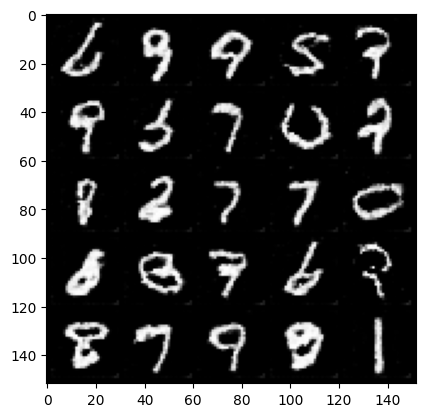

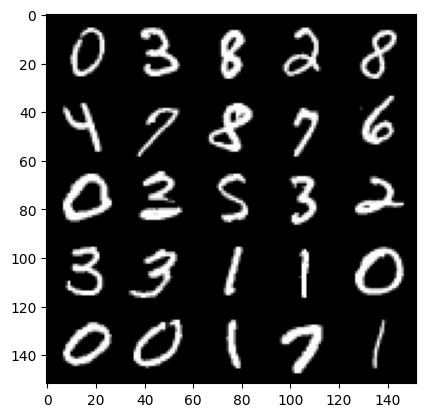

Epoch 34, step 16200: Generator loss: 0.7022320386767388, discriminator loss: 0.6992164686322216


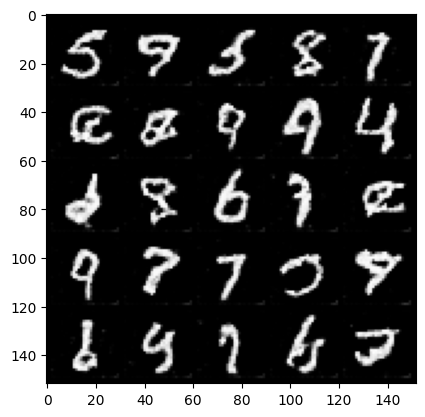

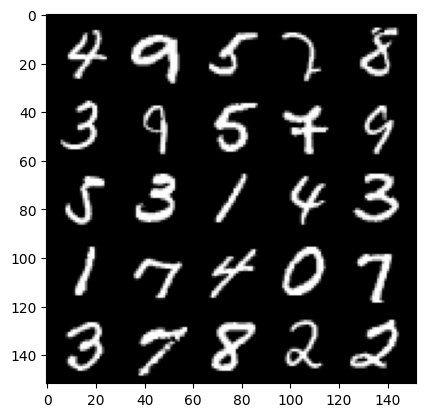

Epoch 34, step 16400: Generator loss: 0.6993697023391721, discriminator loss: 0.69979981303215


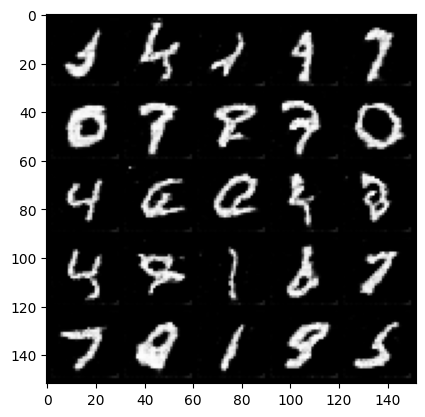

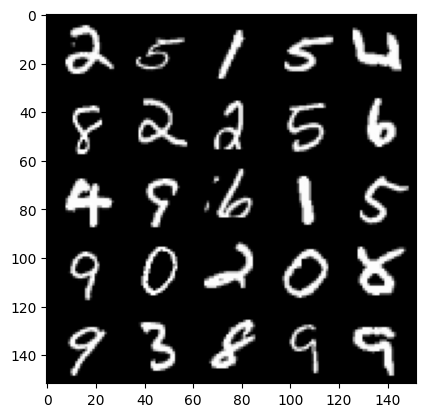

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 35, step 16600: Generator loss: 0.702744400203228, discriminator loss: 0.7004797458648684


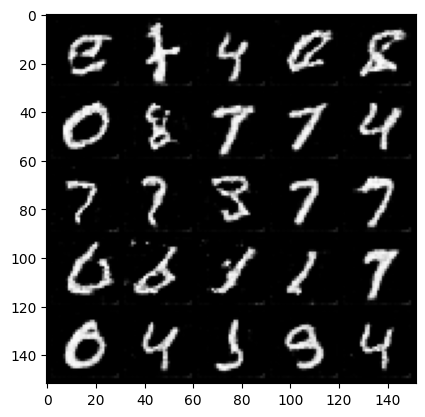

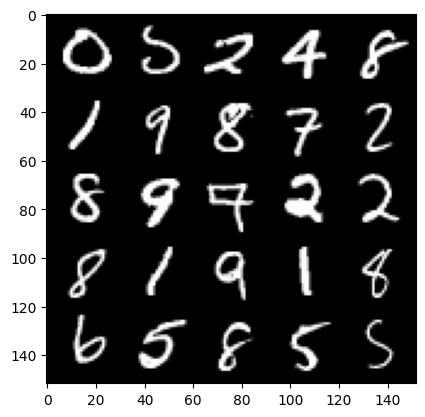

Epoch 35, step 16800: Generator loss: 0.7009005823731425, discriminator loss: 0.7000590479373929


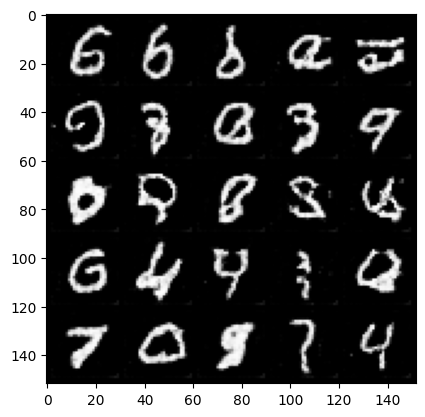

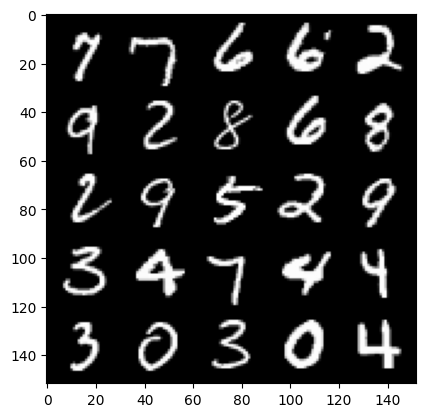

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 36, step 17000: Generator loss: 0.6992705789208409, discriminator loss: 0.700042656660081


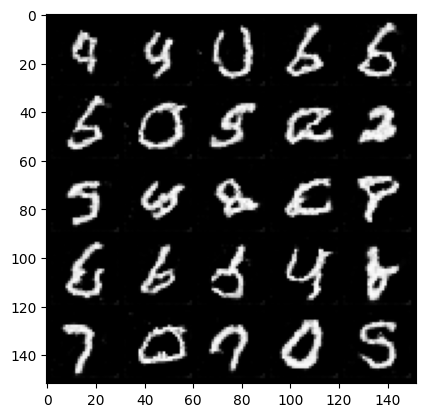

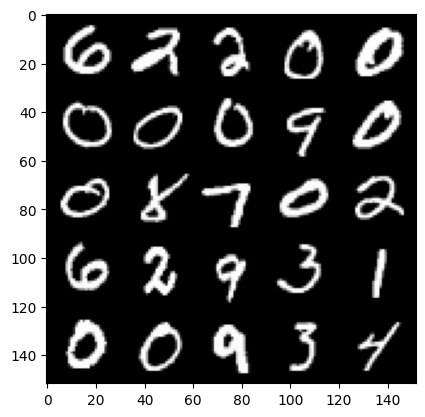

Epoch 36, step 17200: Generator loss: 0.6969381433725353, discriminator loss: 0.7001816004514695


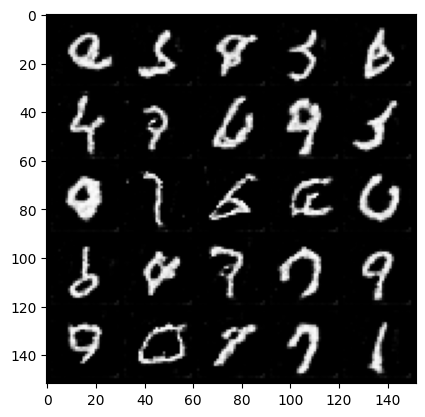

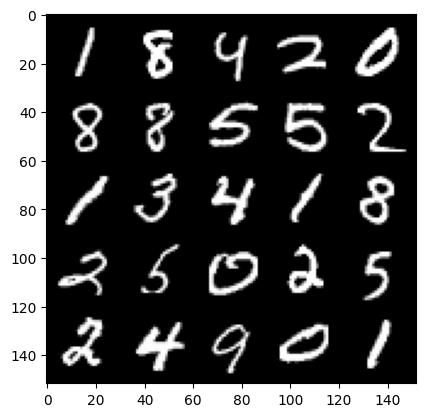

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 37, step 17400: Generator loss: 0.6988027310371396, discriminator loss: 0.6999077656865117


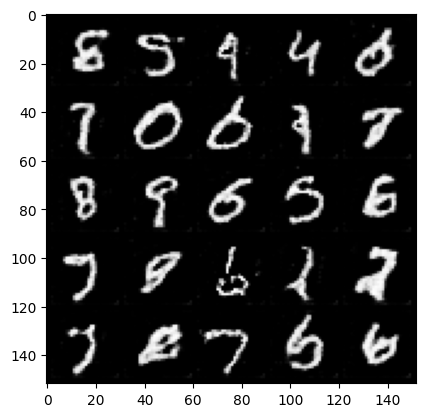

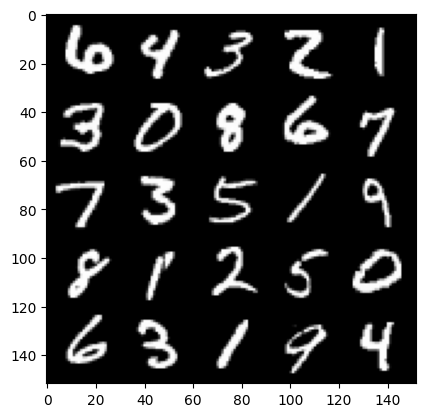

Epoch 37, step 17600: Generator loss: 0.700424953103066, discriminator loss: 0.7003555098176005


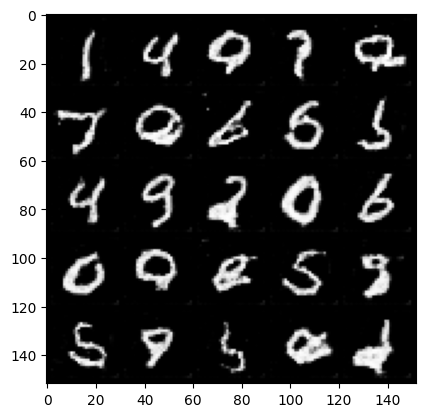

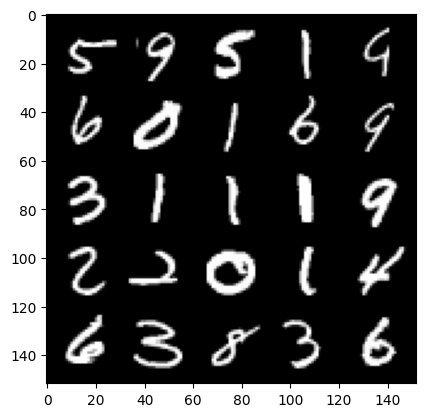

Epoch 37, step 17800: Generator loss: 0.6972061249613762, discriminator loss: 0.7003512403368952


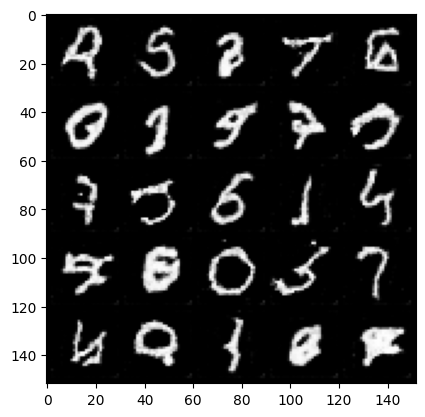

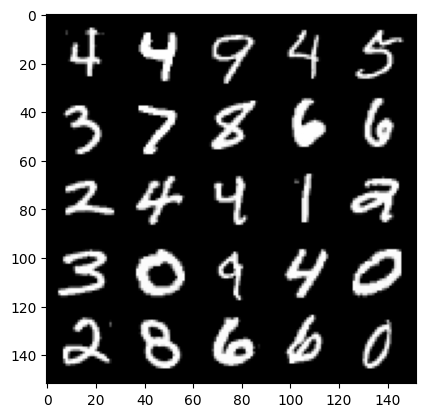

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 38, step 18000: Generator loss: 0.6943700808286662, discriminator loss: 0.6999461230635644


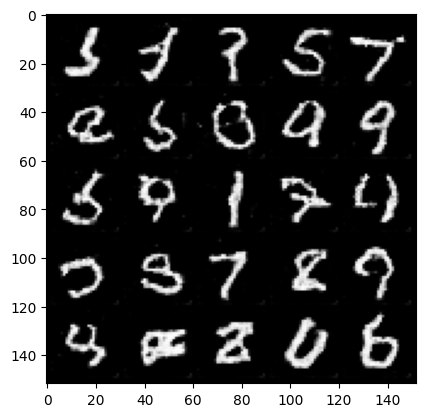

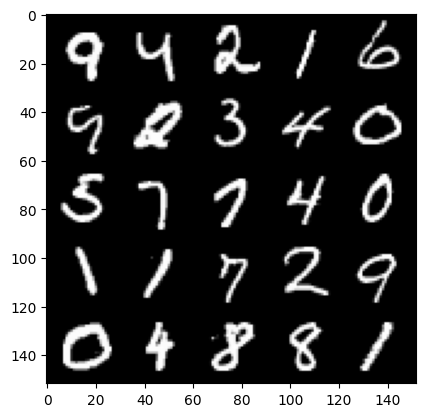

Epoch 38, step 18200: Generator loss: 0.7000741928815845, discriminator loss: 0.7003960162401197


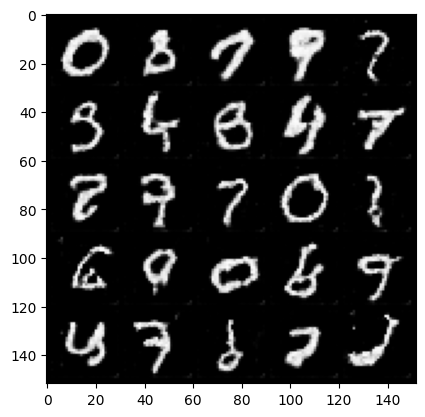

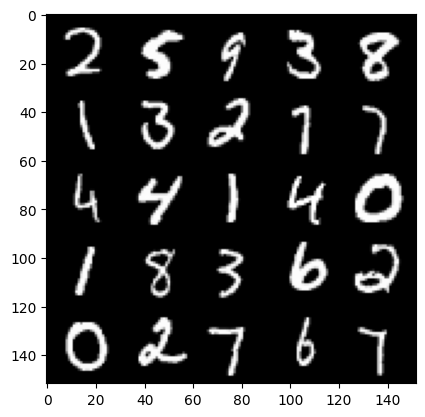

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 39, step 18400: Generator loss: 0.6969733929634099, discriminator loss: 0.6996085590124129


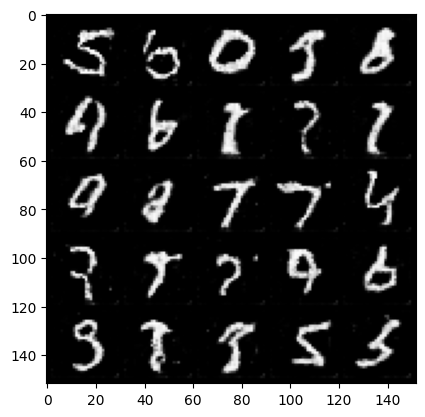

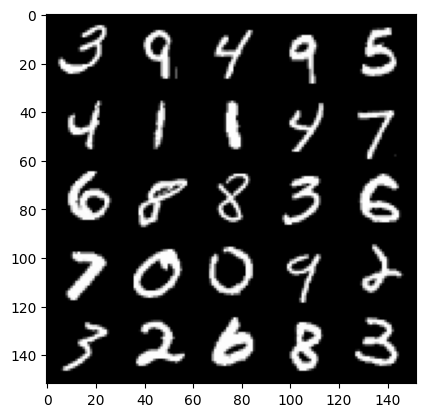

Epoch 39, step 18600: Generator loss: 0.6965949028730396, discriminator loss: 0.6998943504691126


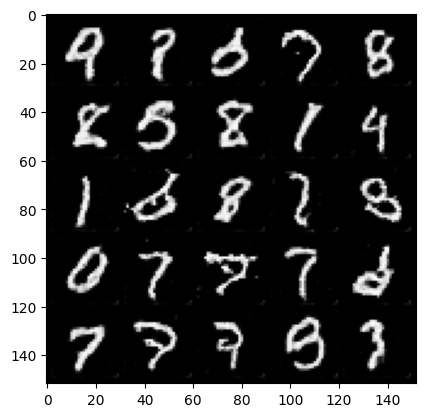

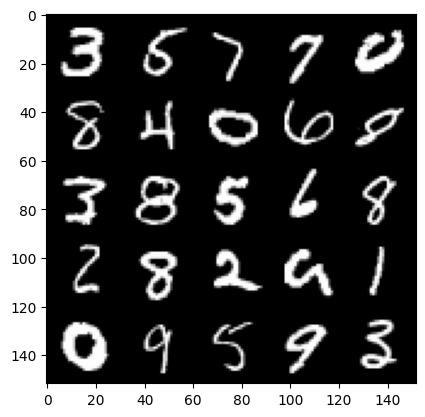

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 40, step 18800: Generator loss: 0.6970196011662487, discriminator loss: 0.6997259607911113


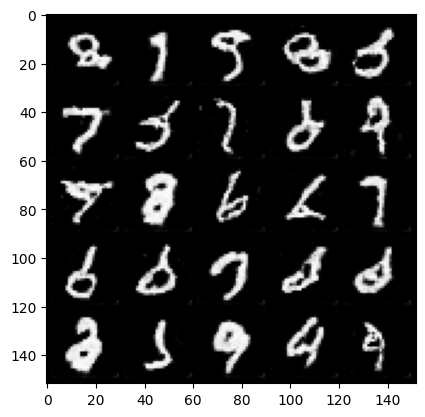

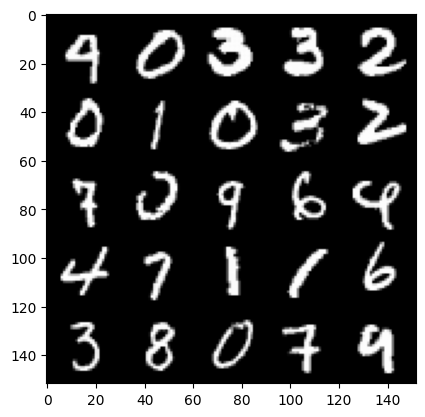

Epoch 40, step 19000: Generator loss: 0.6987243220210076, discriminator loss: 0.699406310617924


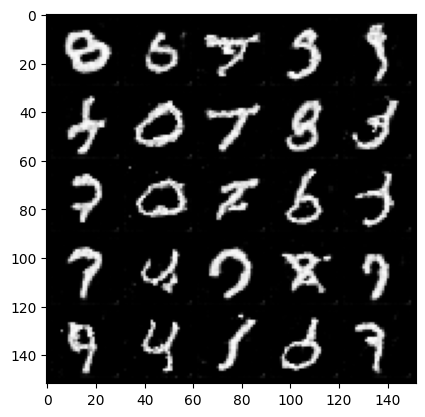

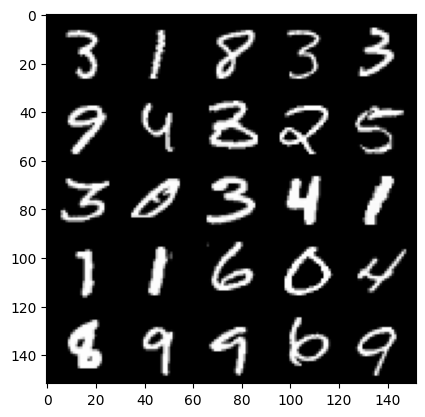

Epoch 40, step 19200: Generator loss: 0.695218984782696, discriminator loss: 0.6998644742369649


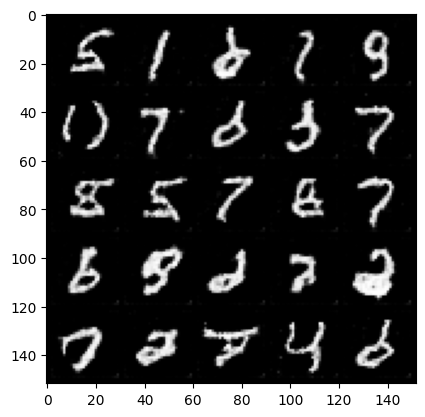

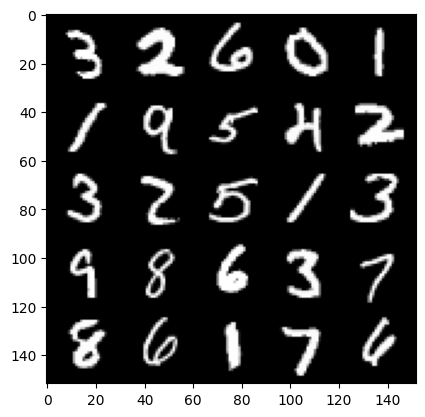

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 41, step 19400: Generator loss: 0.6983307400345805, discriminator loss: 0.6991660878062244


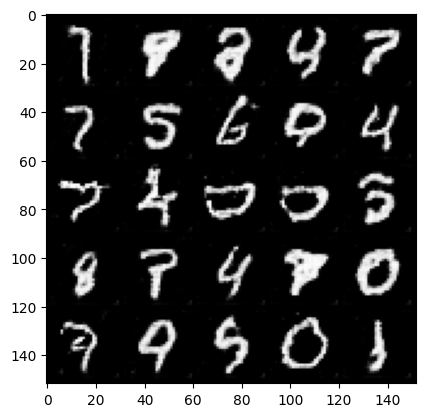

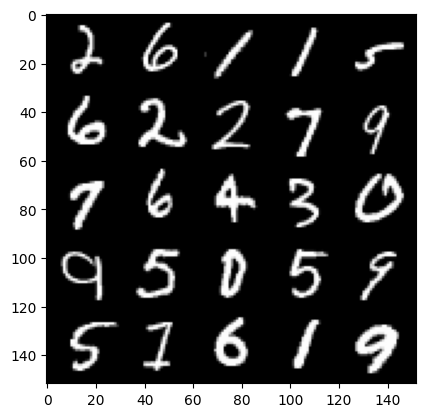

Epoch 41, step 19600: Generator loss: 0.6990857866406442, discriminator loss: 0.6997967135906222


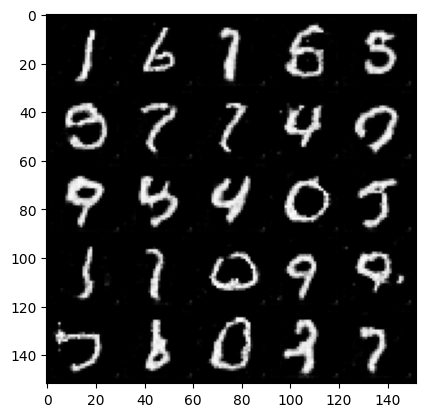

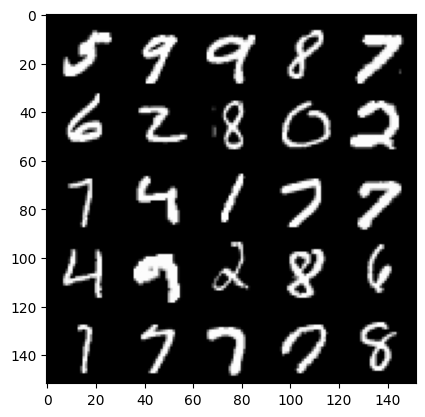

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 42, step 19800: Generator loss: 0.6963298472762105, discriminator loss: 0.6991970744729044


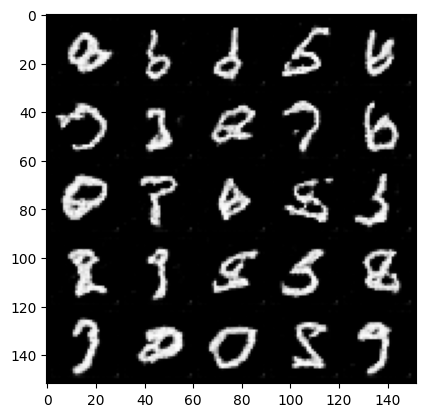

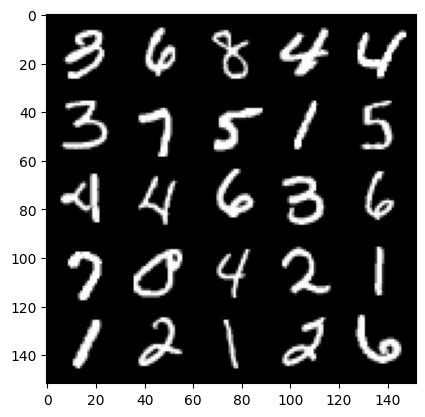

Epoch 42, step 20000: Generator loss: 0.6962621203064918, discriminator loss: 0.6988915443420411


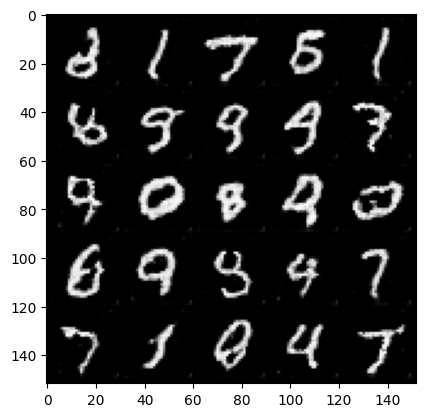

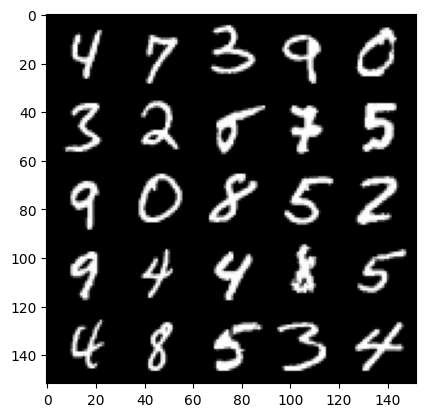

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 43, step 20200: Generator loss: 0.6966229104995725, discriminator loss: 0.6990872722864143


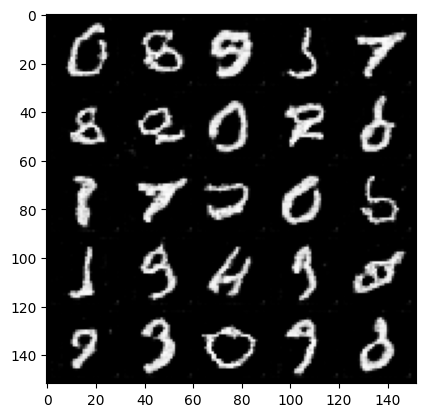

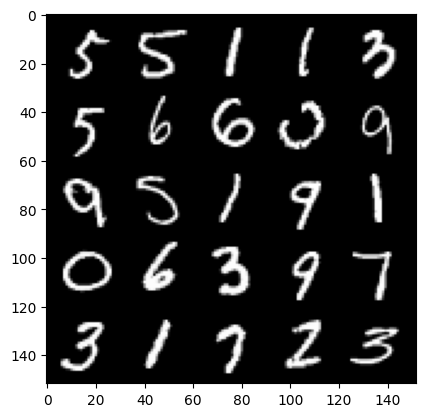

Epoch 43, step 20400: Generator loss: 0.6960543218255045, discriminator loss: 0.6986410140991209


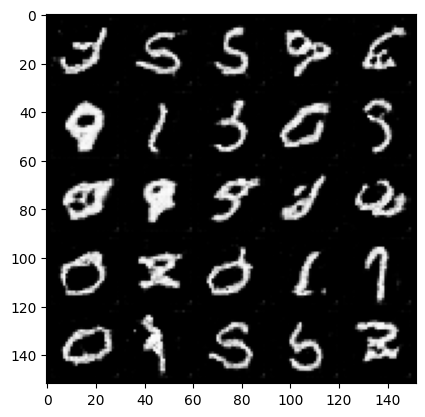

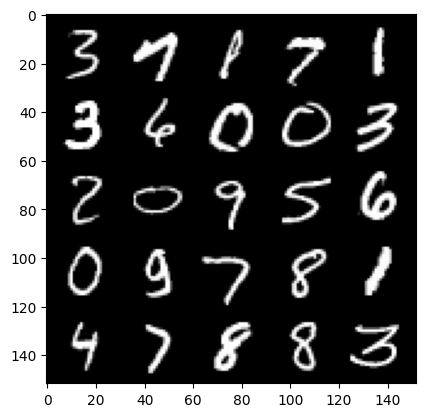

Epoch 43, step 20600: Generator loss: 0.6988265416026114, discriminator loss: 0.6985691994428634


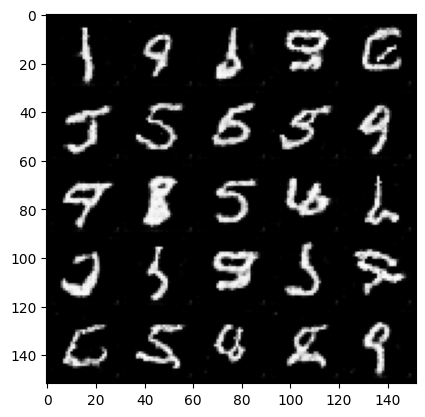

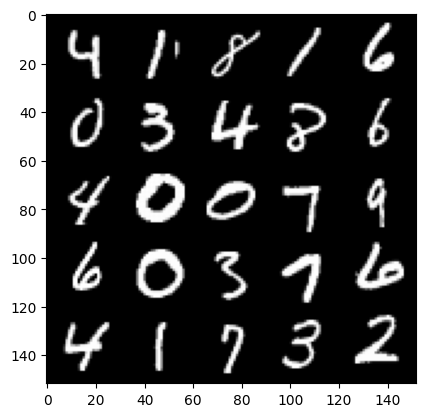

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 44, step 20800: Generator loss: 0.6990671586990357, discriminator loss: 0.6979418799281117


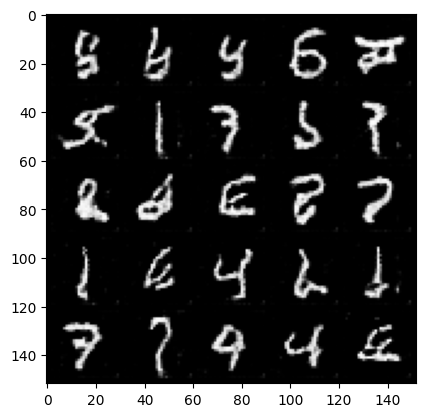

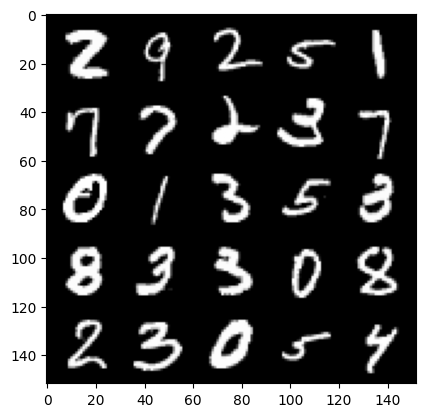

Epoch 44, step 21000: Generator loss: 0.6990495055913926, discriminator loss: 0.6979265326261517


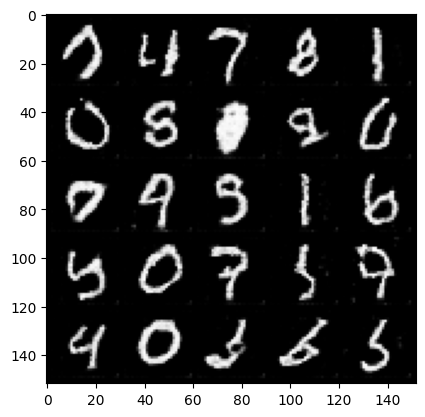

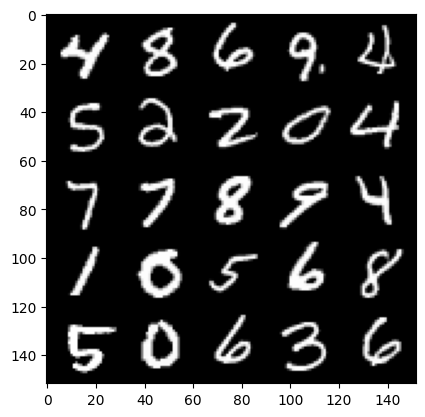

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 45, step 21200: Generator loss: 0.698376891314983, discriminator loss: 0.6971192994713784


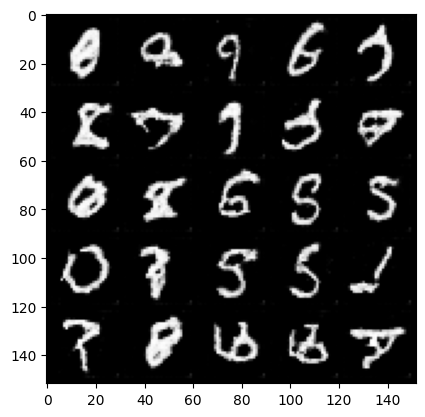

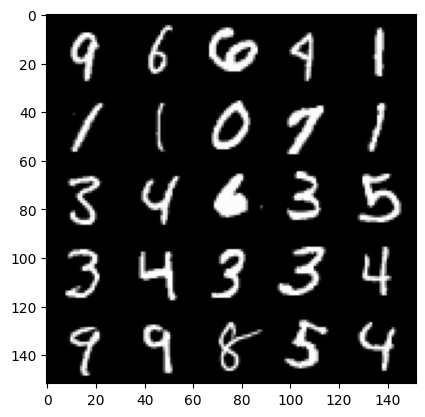

Epoch 45, step 21400: Generator loss: 0.6951703995466233, discriminator loss: 0.699773943424225


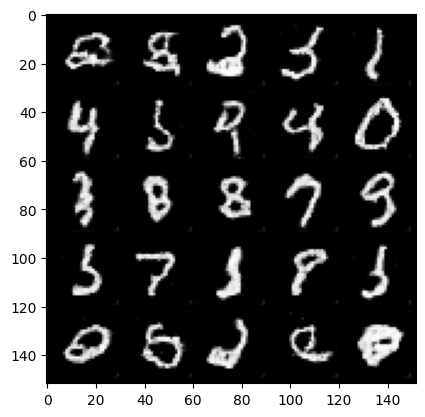

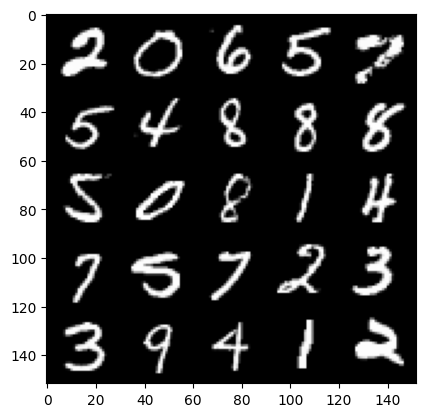

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 46, step 21600: Generator loss: 0.6931896165013316, discriminator loss: 0.6991941770911213


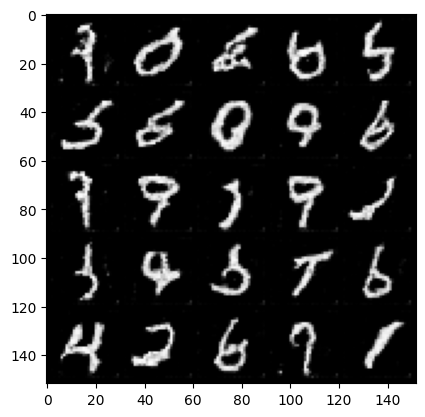

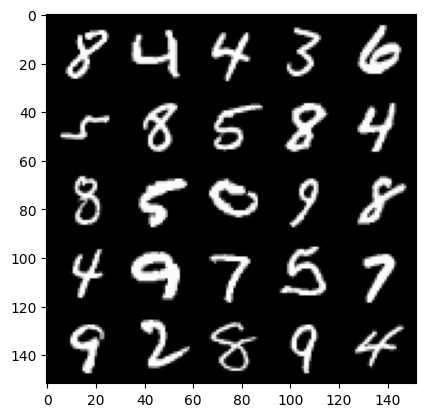

Epoch 46, step 21800: Generator loss: 0.6932528820633886, discriminator loss: 0.698490218818188


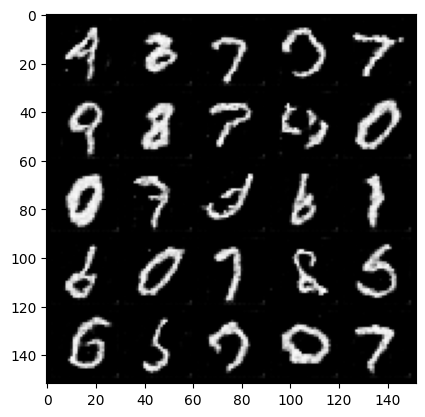

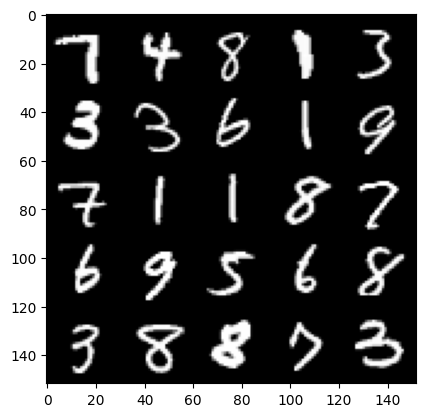

Epoch 46, step 22000: Generator loss: 0.6965826106071472, discriminator loss: 0.698187488913536


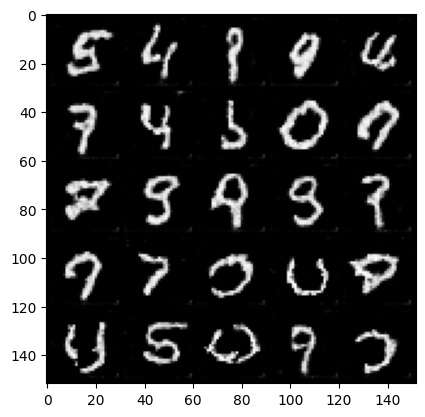

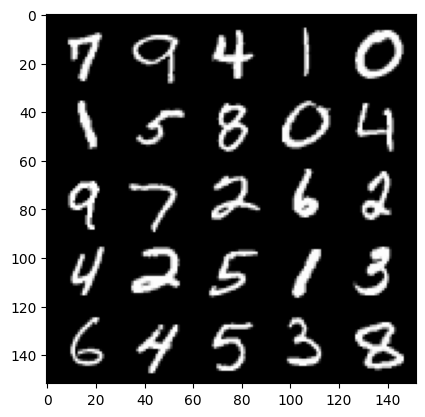

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 47, step 22200: Generator loss: 0.6949740350246432, discriminator loss: 0.6976412245631223


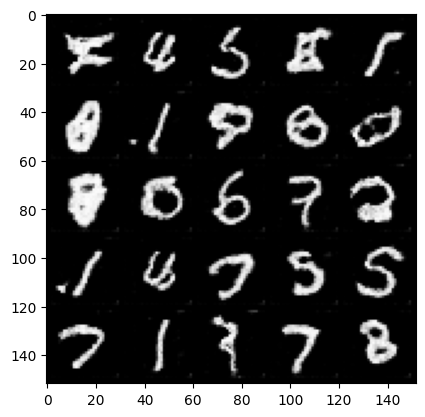

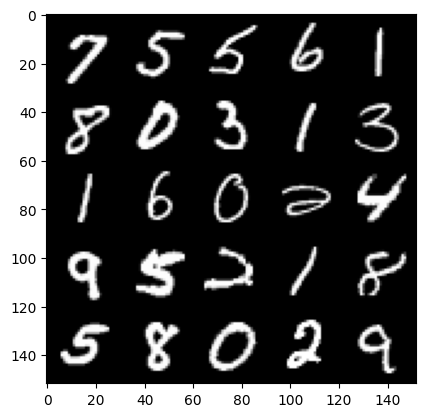

Epoch 47, step 22400: Generator loss: 0.6945309782028193, discriminator loss: 0.6976727446913719


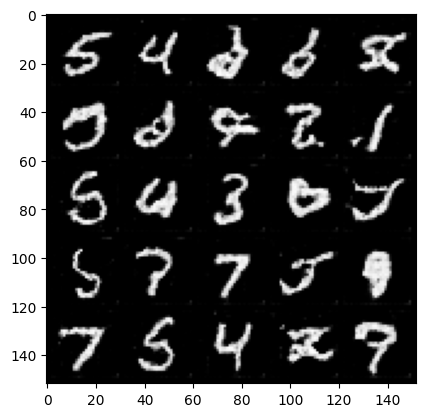

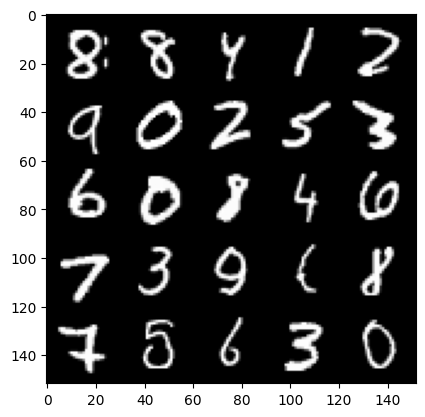

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 48, step 22600: Generator loss: 0.6941920337080958, discriminator loss: 0.6974512791633604


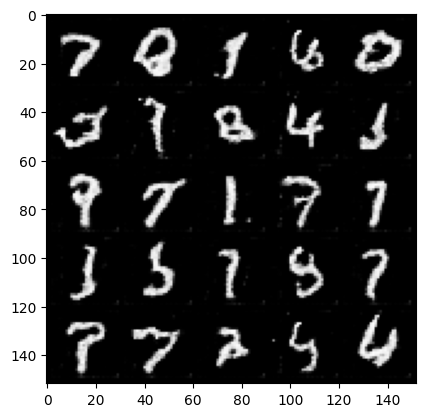

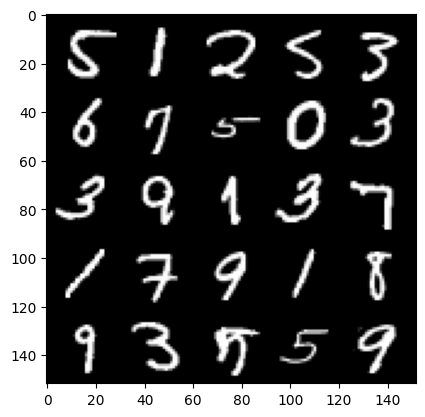

Epoch 48, step 22800: Generator loss: 0.6957437962293627, discriminator loss: 0.6974872550368312


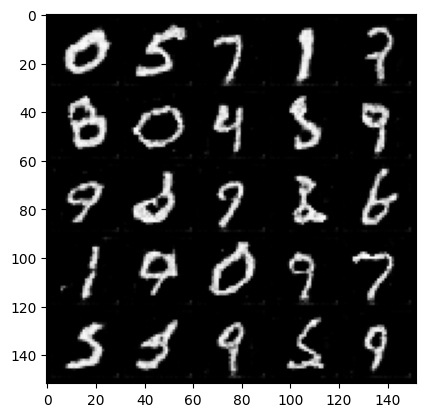

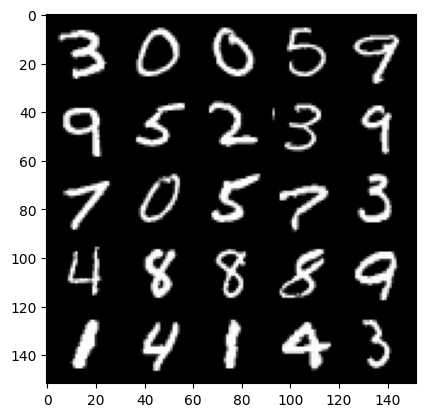

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 49, step 23000: Generator loss: 0.6952177292108537, discriminator loss: 0.6973714342713355


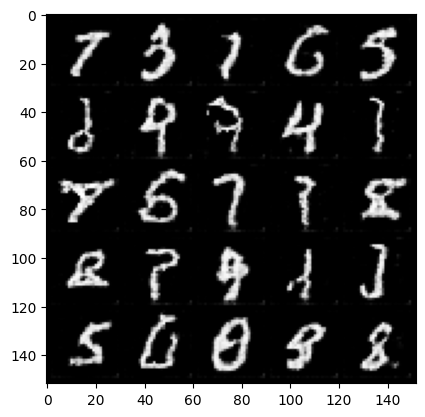

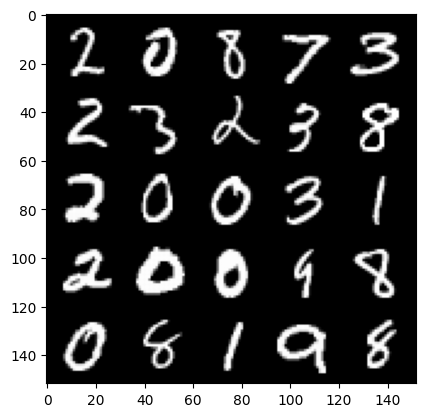

Epoch 49, step 23200: Generator loss: 0.6958341124653818, discriminator loss: 0.6973455792665485


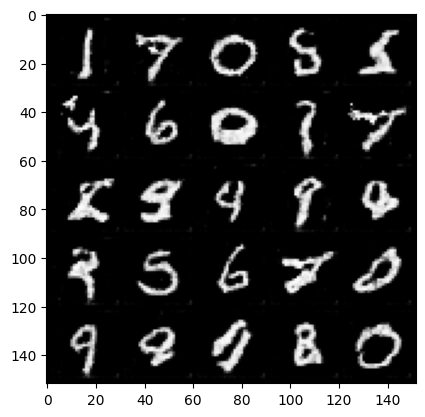

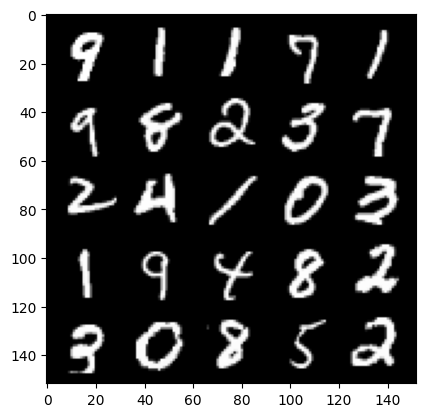

Epoch 49, step 23400: Generator loss: 0.6956096142530445, discriminator loss: 0.6970114761590958


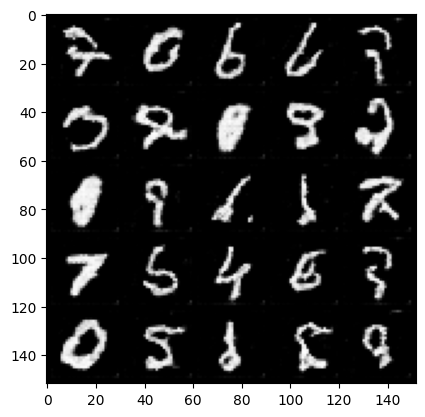

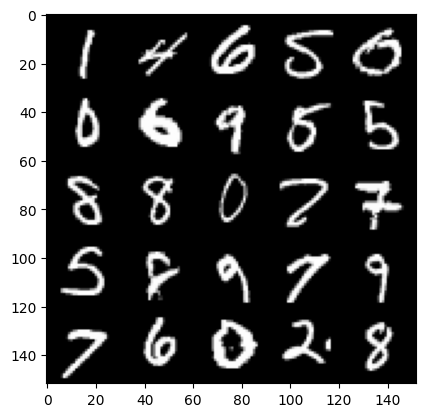

In [44]:
n_epochs = 50
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update discriminator ##
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(fake_noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_pred = disc(real)
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update generator ##
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1
